# Sequence Of Bounding Boxes

* We will generate a sequence of boxes. The prediction capacity of the model is fixed, say 100 boxes.
* A count parameter decide the number of valid boxes.

## Progress

Results of the experiments with simple 3 layer convolution models:

Id | MAX_BOXES | MAX_INPUT_BOXES | Samples | Architecture | Epochs | LR | Loss Fn | Loss | Comments
:---|:---:|:---:|:---:|:---:|:---:|:---:|:---:|---|---|
1 | 5 | 2 | All | (MAX_BOXES, 13, 8)x2 | 5 | Adam Default | HW | 0.2103 -> 0.1616
2 | - | - | 5% | - | 2 | - | - | 0.3104, 0.2478
3 | - | - | - | - | 5 | - | YX + HW | 0.1776 -> 0.1288
4 | - | - | - | (1, 13, 8)x2 | - | InverseDecay(0.001, 0.5, 41) | - | 0.3310 -> 0.1926
5 | - | - | 5 | (MAX_BOXES, 13, 8)x2 | - | - | - | 0.7281 -> 0.1587
6 | - | - | - | - | 100 | - | - | 0.6272 -> 0.0039
7 | - | - | - | - | - | InverseDecay(0.01, 0.5, 41) | - | 0.8359 -> 0.4488| Learning stops after 8 epochs with YX and HW stuck at 0.4248 and 0.0240.
8 | - | - | All | ((MAX_BOXES, 13, 8)x2->(MAX_BOXES, 3, 2)x2)xYXHW | 60 | InverseDecay(0.001, 0.5, All*10) | Log(Pred_HW/True_HW) | 1.9265 -> 0.9799 | Predicted HW are within .5X of true HW.
9 | - | - | 5% | - | 100 | - | YX | 3.8099 -> 3.7289 | YX: 0.1098 -> 0.0029. Position encodings for Ys.
10 | - | - | - | - | - | - | 50*YX + HW | 2.9508 -> 0.3691 | IoU: -0.1826 -> 0.3840.
11 | - | - | All | - | 70 | - | - | 1.8581 -> 0.9644 | Negative IoU. Final YX Loss: 0.0420. Final HW Loss: 0.9225
12 | - | - | 5% | - | 100 | - | 50*YX + HW + (1 - IoU) | 2.1867 -> 0.4925| YX: 0.1064 -> 0.0038, HW: 2.0804 -> 0.4887, IoU: -0.2039 -> 0.3807
13 | 10 | 6 | - | - | - | - | - | 2.7591 -> 0.3115 | YX: 0.1031 -> 0.0107, HW: 2.6561 -> 0.3008, IoU: -0.0776 -> 0.0741





## Questions

- [] Inverted model which accepts box inputs (cell coordinates) and outputs box dimensions.
- [] Image patch as inputs and box coordinates as outputs.
- [] Reverse convolution from small random value to an image using Deconv operations.
- [x] Model isn't detecting faces.
- [x] Raster ordering forces incorrect order for the boxes with slightly different Y but wildly different X.


## Investigations
- [x] Check the output of various conv layer for the 10, 6 boxes run.

Document: https://docs.google.com/document/d/14vPryt1JFE6Si89VamwMOi-RASeXmMXpo0_BjT_hn-U/edit?usp=sharing

In [9]:
# !pip install -q git+https://github.com/EfficientDL/codelab_utils.git

import pickle
import PIL
import math
import albumentations

import codelab_utils.mpl_styles as mpl_styles
import numpy as np
import seaborn as sns
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_model_optimization as tfmot

from tensorflow.keras import layers, optimizers, metrics, losses, utils
from tensorflow.keras import applications as apps, callbacks as cbs
from tensorflow.keras.utils import plot_model
from matplotlib import pyplot as plt
from matplotlib import patches as patches
from itertools import accumulate
from functools import reduce

mpl_styles.set_default_styles()
plt.rcParams['font.family'] = 'Poppins'

DEBUG = False

## Dataset Initialization

In [10]:
# Load wider_face dataset
train_ds, val_ds, test_ds = tfds.load(
    'wider_face',
    # split=['train[:80%]', 'train[80%:]', 'test'],
    split=['train[:5]', 'validation[:5%]', 'test[:5%]'],
    # split=['train', 'validation', 'test'],
    read_config=tfds.ReadConfig(try_autocache=False)
)

## Box Functions

In [11]:
def make_random_boxes(num_boxes=1):
    """
        It creates random boxes in YXYX format.

        Arguments:
            num_boxes: The number of boxes to create.
        
        Returns:
            A tensor of boxes with shape (num_boxes, 4) with FP values.
            All the values are in range [0., 1.]
    """
    pair_1 = tf.random.uniform((num_boxes, 2))
    pair_2 = tf.random.uniform((num_boxes, 2))

    yx_min = tf.where(pair_1 < pair_2, pair_1, pair_2)
    yx_max = tf.where(pair_1 > pair_2, pair_1, pair_2)

    boxes = tf.concat([yx_min, yx_max], axis=-1)
    return boxes

def make_random_grid_boxes(num_boxes, grid_size):
    """
        Generates a random boxes in a grid.

        Arguments:
            num_boxes: An integer value to indicate the number of boxes to generate.
            grid_size: The size of target grid to fit the boxes into.
        
        Returns:
            A grid containing heights and widths of input boxes fitted based on their top-left coordinates.
            The output shape is (grid_size, grid_size, 2)
    """
    pair_1 = tf.random.uniform((num_boxes, 2))
    pair_2 = tf.random.uniform((num_boxes, 2))

    yx_min = tf.where(pair_1 < pair_2, pair_1, pair_2)
    yx_max = tf.where(pair_1 > pair_2, pair_1, pair_2)

    boxes = tf.concat([yx_min, yx_max], axis=-1)
    box_grid = yxyx_to_hw_grid(boxes, grid_size)

    # box_indices = tf.cast(tf.random.uniform((num_boxes, 2))*grid_size, dtype=tf.int32)
    # box_grid = tf.scatter_nd(indices=box_indices, updates=boxes, shape=(grid_size, grid_size, 4))

    # tf.print('box_indices: ', box_indices, box_indices.shape)
    # tf.print('boxes: ', boxes, boxes.shape)
    # tf.print('box_grid: ', box_grid, box_grid.shape)

    return box_grid

def yx_to_indices(yx, size, dtype=tf.int64):
    return tf.cast(yx*(size - 1), dtype)

def yxyx_to_hw_grid(boxes, grid_size):
    """
        It fits a tensor of flat boxes to a grid of given size.

        Arguments:
            boxes: A tensor of boxes in YXYX format with shape (N_BOXES, 4)
            grid_size: An integer value indicating the size of the target grid.
        
        Returns:
            A grid containing heights and widths of input boxes fitted based on their top-left coordinates.
            The output shape is (grid_size, grid_size, 2)
    """
    yx_min, yx_max = tf.split(boxes, 2, axis=-1)
    hw = yx_max - yx_min

    box_indices = yx_to_indices(yx_min, grid_size, dtype=tf.int32)
    box_grid = tf.scatter_nd(indices=box_indices, updates=hw, shape=(grid_size, grid_size, 2))
    
    return box_grid

def yxkk_to_kk_grid(boxes, grid_size):
    """
        It fits a tensor of flat boxes to a grid of given size.

        Arguments:
            boxes: A tensor of boxes in YXKK format with shape (N_BOXES, 4)
            grid_size: An integer value indicating the size of the target grid.
        
        Returns:
            A grid containing heights and widths of input boxes fitted based on their top-left coordinates.
            The output shape is (grid_size, grid_size, 2)
    """
    yx_min, kk = tf.split(boxes, 2, axis=-1)

    box_indices = yx_to_indices(yx_min, grid_size, dtype=tf.int32)
    box_grid = tf.scatter_nd(indices=box_indices, updates=kk, shape=(grid_size, grid_size, 2))
    
    return box_grid

def hw_grid_to_yxhw(grid):
    """
        It translates a square HW grid to a list of boxes. Only the boxes with non-zero heights
        are qualified.

        Arguments:
            grid: A grid of of shape: (SIZE, SIZE, 2) with HW values in the last dimension.
        
        Returns:
            A tensor of shape (N_BOXES, 4). The last dimension contains YXHW values.
    """
    # Grid size
    size = grid.shape[0]

    # Generate valid box indices. We consider the boxes with non-zero heights as valid boxes
    mask = tf.cast(tf.math.not_equal(grid[:, :, 0], 0.), tf.float32)
    indices = tf.where(mask)

    # Compute YX and HW for valid boxes
    yx = tf.cast(indices/size, dtype=tf.float32)
    hw = tf.gather_nd(indices=indices, params=grid)

    # tf.print('indices: ', indices, indices.shape)
    # tf.print('first grid element', grid[indices[0][0], indices[0][1]])
    # tf.print('last grid element', grid[indices[-1][0], indices[-1][1]])

    yxhw = tf.concat([yx, hw], axis=-1)

    return yxhw

def yxyx_to_cycxhw_grid(boxes, grid_size):
    """
        It converts a tensor of YXYX boxes into a grid of HW values.
        HW values are inserted based on CYCX values into the grid.

        boxes: A tensor of boxes. Shape: (N_BOXES, 4). The last dimension
            contains YXYX values.
        grid_size: The size of the grid to insert HW values.

        Returns:
            A grid with HW values. Shape: (grid_size, grid_size, 2)
    """
    # Compute box CYCX and HW.
    cy, cx = (boxes[:, 0] + boxes[:, 2])/2, (boxes[:, 1] + boxes[:, 3])/2
    cycx, hw = tf.stack([cy, cx], axis=-1), boxes[:, 2:] - boxes[:, :2]

    # Find the grid indices corresponding to the box centers.
    indices = yx_to_indices(cycx, grid_size, dtype=tf.int32)
    
    # tf.print('indices: ', indices, indices.shape)

    # Construct the grid based on the center indices and HW values
    grid = tf.scatter_nd(indices=indices, updates=hw, shape=(grid_size, grid_size, 2))

    # tf.print('grid: ', grid, grid.shape)

    return grid

def yxyx_to_yxhw(boxes):
    """
        It translates the boxes from YXYX format to YXHW format.
        boxes: A tensor of boxes with shape (N_BOXES, 4) in YXYX format.

        Returns:
            A tensor of boxes with shape (N_BOXES, 4) in YXHW format.
    """
    yx_min, yx_max = tf.split(boxes, 2, axis=-1)
    hw = yx_max - yx_min
    hw_boxes = tf.concat([yx_min, hw], axis=-1)
    return hw_boxes

def yxhw_to_yxyx(boxes):
    """
        It translates the boxes from YXHW format to YXYX format.
        boxes: A tensor of boxes with shape (N_BOXES, 4) in YXHW format.

        Returns:
            A tensor of boxes with shape (N_BOXES, 4) in YXYX format.
    """
    yx_min, yx_hw = tf.split(boxes, 2, axis=-1)
    yx_max = tf.clip_by_value(yx_min + yx_hw, 0, 1)
    yxyx_boxes = tf.concat([yx_min, yx_max], axis=-1)
    return yxyx_boxes

def cycxhw_to_yxyx(boxes):
    """
        It translates the boxes from CYCXHW format to YXYX format.
        boxes: A tensor of boxes with shape (N_BOXES, 4) in CYCXHW format.

        Returns:
            A tensor of boxes with shape (N_BOXES, 4) in YXYX format.
    """
    cycx, hw = tf.split(boxes, 2, axis=-1)
    hw_half = hw/2

    yx_min = tf.clip_by_value(cycx - hw_half, 0, 1)
    yx_max = tf.clip_by_value(cycx + hw_half, 0, 1)
    yxyx_boxes = tf.concat([yx_min, yx_max], axis=-1)
    return yxyx_boxes

def yxhw_to_cycxhw(boxes):
    """
        It translates the boxes from CYCXHW format to YXHW format.
        boxes: A tensor of boxes with shape (N_BOXES, 4) in CYCXHW format.

        Returns:
            A tensor of boxes with shape (N_BOXES, 4) in YXHW format.
    """
    yx, hw = tf.split(boxes, 2, axis=-1)
    hw_half = hw/2

    cycx = tf.clip_by_value(yx + hw_half, 0, 1)
    cycxhw_boxes = tf.concat([cycx, hw], axis=-1)
    return cycxhw_boxes

def box_area(boxes):
    """
        It computes the area of the boxes.
        boxes: A tensor of boxes with shape (N_BOXES, 4) in YXYX format.

        Returns:
            A tensor of box areas of shape (N_BOXES, 1)
    """
    y_min, x_min, y_max, x_max = tf.split(boxes, 4, axis=-1)
    return (y_max - y_min)*(x_max - x_min)

# random_boxes = tf.map_fn(lambda v: make_random_grid_boxes(v[0], v[1]), [tf.constant([2, 3]), tf.ones((2))*4], fn_output_signature=tf.float32)

In [12]:
IMG_SIZE = 256
# MAX_BOXES = 2
# MAX_BOXES = 5
# MAX_INPUT_BOXES = 2
# MAX_BOXES = 10
# MAX_INPUT_BOXES = 6
MAX_BOXES = 500
MAX_INPUT_BOXES = 400

def resize_fn(bboxes, current_shape, target_size=IMG_SIZE):
    # Resize ratios
    H, W = current_shape
    ratio_H, ratio_W = target_size/H, target_size/W
    bboxes = bboxes*[ratio_H, ratio_W, ratio_H, ratio_W]

    return bboxes
    # return bboxes.astype('float32')

def preprocess_as_center_grid(item):
    image, boxes = item['image'], item['faces']['bbox']
    # tf.print('boxes: ', boxes, boxes.shape)

    # Resize image to IMG_SIZE
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    image = tf.cast(image, tf.float32) / 255.0

    # Transform YXYX boxes to CYCX
    resized_boxes = resize_fn(boxes, image.shape[:-1], IMG_SIZE)[:MAX_INPUT_BOXES-1]
    resized_boxes.set_shape([None, 4])

    # Map CYCXHW coordinates to a grid of size IMG_SIZE
    grid = yxyx_to_cycxhw_grid(resized_boxes, IMG_SIZE)

    # tf.print('cycx_boxes: ', cycx_boxes, cycx_boxes.shape)
    # tf.print('grid: ', grid, grid.shape)

    return image, grid

@tf.function
def filter_empty_bboxes(item):
    _, bboxes = item['image'], item['faces']['bbox']

    return tf.shape(bboxes)[0] != 0

train_prep_ds = train_ds.filter(filter_empty_bboxes).map(preprocess_as_center_grid, num_parallel_calls=None)
val_prep_ds = val_ds.filter(filter_empty_bboxes).map(preprocess_as_center_grid, num_parallel_calls=tf.data.AUTOTUNE)
test_prep_ds = test_ds.map(preprocess_as_center_grid, num_parallel_calls=tf.data.AUTOTUNE)

# bitr = iter(train_prep_ds.batch(2))
# images, y_true = next(bitr)
# images.shape, y_true.shape

# itr = iter(train_prep_ds)
# image, y_true = next(itr)

# display('image', image)
# display('y_true', y_true), tf.math.reduce_sum(mask, axis=-2)
# itr = iter(train_ds)
# item = next(itr)
# image, boxes = item['image'], item['faces']['bbox']
# image, mask = tf.function(preprocess_as_box_center_mask)(item)
# image, y_true = preprocess_as_center_grid(item)

## Plotting Functions

In [13]:
def plot_box_centers(ax, boxes, size, color='green', alpha=1.0, marker_size=None):
    """
        ax: Plot Axes.
        boxes: A tensor of CYCXHW values for the box centers. Shape: (N_BOXES, 4)
        size: Size of the image. It is used to translate the CYCX values to image size.
        color: A string to indicate the color in matplotlib format for the bounding boxes.
        alpha: A FP value for the box fill.
    """
    if boxes is None: return

    boxes = boxes*size
    y, x = boxes[:, 0], boxes[:, 1]

    ax.scatter(x, y, color=color, s=marker_size, alpha=alpha)

    for box_id, yi in enumerate(y):
        xi = x[box_id]
        ax.text(xi, yi, str(box_id + 1), ha='center', va='center', size='xx-small', color='white')

def plot_examples(images, y_true, y_pred, cols=3, match=False, max_pred_boxes=MAX_BOXES):
    """
        It plots true and predicted bounding boxes over the images.

        Arguments:
            images: A tensor of images. Shape: (BATCH_SIZE, IMG_SIZE, IMG_SIZE, 3)
            y_true: A grid of box HW values for each feature point. Shape: (BATCH_SIZE, SIZE, SIZE, 2)
            y_pred: A tensor of YXHW values for predicted boxes. Shape: (N_BOXES, 4)
            cols: The number of columns in the plot.
            match: If true, we truncate the predicted boxes to the number of true boxes.
    """
    batch_size = y_pred.shape[0] if y_pred is not None else y_true.shape[0]

    # Plot configuration
    rows = (batch_size + cols - 1)//cols
    fig, axes = plt.subplots(rows, cols, figsize=(8, rows*3))
    color_1, color_2, color_i, color_n = ['red', 'green', 'blue', 'yellow']
    axes = axes.ravel()

    def slice_ys(item_id):
        item_y_true = None if y_true is None else hw_grid_to_yxhw(y_true[item_id])

        # tf.print('item_y_true: ', item_y_true, item_y_true.shape)

        num_y_pred_boxes = tf.shape(item_y_true)[0] if match and item_y_true is not None else max_pred_boxes
        item_y_pred = None if y_pred is None else y_pred[item_id, :num_y_pred_boxes]

        return item_y_true, item_y_pred

    for item_id in range(batch_size):
        # Plot image
        axes[item_id].imshow(images[item_id])

        item_y_true, item_y_pred = slice_ys(item_id)

        # Plot predicted boxes
        plot_box_centers(axes[item_id], item_y_pred, IMG_SIZE, color_2, marker_size=20)
        plot_box_centers(axes[item_id], item_y_true, IMG_SIZE, color_1, alpha=0.5)

        # Add box counts as plot title.
        title = ' | '.join(
            map(
                lambda x: str(int(tf.shape(x)[0])),
                filter(
                    lambda x: x is not None,
                    [item_y_pred, item_y_true]
                )
            )
        )
        axes[item_id].set_title(title)

    plt.tight_layout()

# itr = iter(train_prep_ds.batch(2))
# images, y_true = next(itr)

# y_pred = tf.random.uniform((2, 20, 4))
# plot_examples(images, y_true, y_pred)
# plot_examples(images, y_true, None)

# r = patches.Rectangle([0, 0], 5, 5)


## Training and Validation Examples

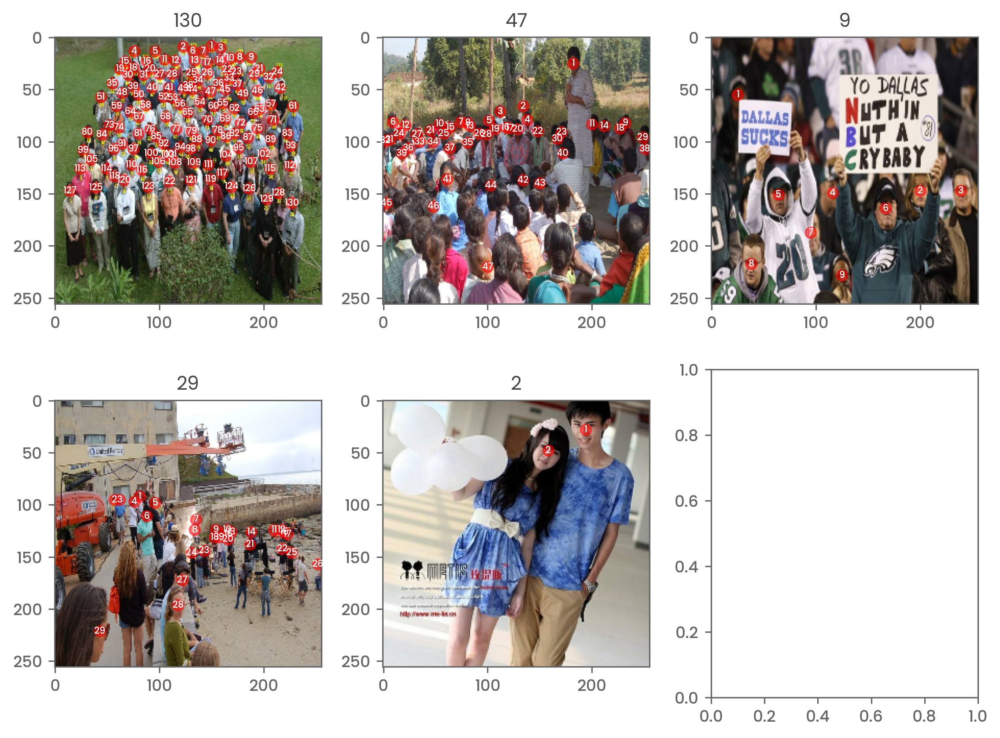

In [14]:
itr = iter(train_prep_ds.batch(20))
images, y_true = next(itr)

plot_examples(images, y_true, None)

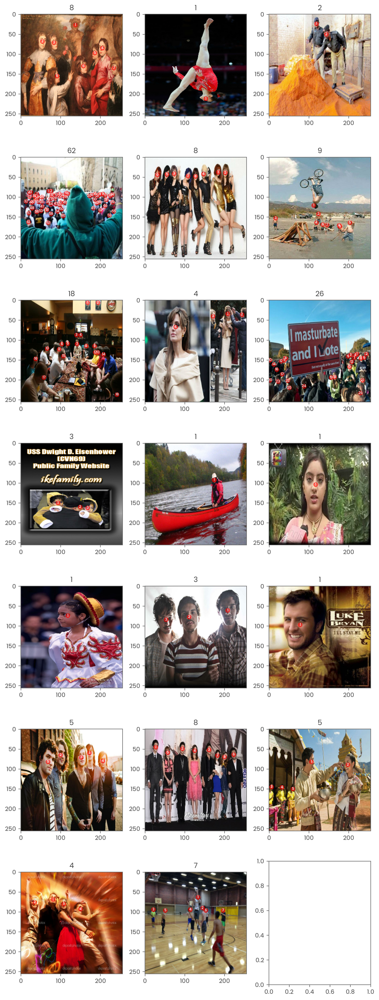

In [15]:
itr = iter(val_prep_ds.batch(20))
images, y_true = next(itr)

plot_examples(images, y_true, None)

## Loss Function and Evaluation Metrics

### YXHW Loss Function

In [16]:
LOSS_EPSILON = 1/(IMG_SIZE*IMG_SIZE*IMG_SIZE*IMG_SIZE)

def compute_item_yxhw_loss(true_boxes, pred_boxes):
    """
        It computes MAE loss for YX and HW values between true and predicted boxes.
        The losses are computed just for the valid boxes
        Arguments:
            true_boxes: A tensor of boxes with shape (IMG_SIZE, IMG_SIZE, 2)
            The last dimension contains heights and widths of the boxes.

            pred_boxes: A tensor of boxes with shape (N_BOXES, 4)
            The last dimension contains YXHW values.

        Returns:
            * YX Loss
            * HW Loss
            * Box Count
    """
    # Input Grid Size
    size = true_boxes.shape[0]

    # Generate valid box indices. We consider the boxes with non-zero heights as valid boxes
    boxes_grid_mask = tf.cast(tf.math.not_equal(true_boxes[:, :, 0], 0.), tf.float32)
    boxes_grid_indices = tf.where(boxes_grid_mask)

    # Compute the number of valid boxes and a linear valid box mask.
    num_boxes = tf.shape(boxes_grid_indices)[0]

    # tf.print('boxes_grid_indices: ', boxes_grid_indices, boxes_grid_indices.shape)
    # tf.print('num_boxes: ', num_boxes)

    # Compute YX and HW for valid boxes
    yx_boxes = tf.cast(boxes_grid_indices/size, dtype=tf.float32)
    hw_boxes = tf.gather_nd(indices=boxes_grid_indices, params=true_boxes)

    # tf.print('yx_boxes: ', yx_boxes, tf.shape(yx_boxes))
    # tf.print('hw_boxes: ', hw_boxes, tf.shape(hw_boxes))

    # We'll compute YX and HW losses individually.
    # We split the pred_boxes into YX and HW.
    yx_pred, hw_pred = tf.split(pred_boxes, 2, axis=-1)

    # tf.print('yx_pred: ', yx_pred, tf.shape(yx_pred))
    # tf.print('hw_pred: ', hw_pred, tf.shape(hw_pred))

    # Compute HW loss
    yx_loss = tf.math.square(yx_pred[:num_boxes] - yx_boxes)
    hw_loss = tf.math.abs(tf.math.log((hw_pred[:num_boxes] + LOSS_EPSILON)/(hw_boxes + LOSS_EPSILON)))

    # tf.print('yx_loss: ', yx_loss, tf.shape(yx_loss))
    # tf.print('hw_loss: ', hw_loss, tf.shape(hw_loss))

    return tf.math.reduce_sum(yx_loss), tf.math.reduce_sum(hw_loss), num_boxes

def compute_yxhw_loss(y_true, y_pred):
    yx_loss, hw_loss, num_boxes = 0., 0., 0
    batch_size = tf.shape(y_true)[0]

    for item_id in range(batch_size):
        # item_id = 0
        result  = compute_item_yxhw_loss(y_true[item_id], y_pred[item_id])
        item_yx_loss, item_hw_loss, item_num_boxes = result

        yx_loss += item_yx_loss
        hw_loss += item_hw_loss
        num_boxes += item_num_boxes

        # tf.print('item_hw_loss:{}: '.format(item_id), item_hw_loss)
        # tf.print('item_num_boxes:{}: '.format(item_id), item_num_boxes)

    # tf.print('num_boxes: ', num_boxes)
    # tf.print('yx_loss: ', yx_loss)
    # tf.print('hw_loss: ', hw_loss)
    
    yx_loss /= tf.cast(num_boxes, dtype=tf.float32)
    hw_loss /= tf.cast(num_boxes, dtype=tf.float32)

    # tf.print('loss: ', loss)

    return yx_loss, hw_loss


compute_yxhw_loss.__name__ = 'loss'

# y_true = tf.map_fn(lambda v: tf.function(make_random_grid_boxes)(v[0], v[1]), [tf.constant([2, 3]), tf.ones((2))*4], fn_output_signature=tf.float32)
# y_pred = tf.random.uniform((2, MAX_BOXES, 4))
# # y_true = tf.map_fn(lambda v: make_random_grid_boxes(v[0], v[1]), [tf.constant([4]), tf.ones((1))*4], fn_output_signature=tf.float32)
# # y_pred = tf.random.uniform((1, 4, 4, 2))
# display('y_true', y_true[0])
# display('y_pred', y_pred[0])
# compute_yxhw_loss(y_true, y_pred)

### Signed IoU Metrics

In [17]:
class Mean(metrics.Metric):
    def __init__(self, name="mean", **kwargs):
        super(Mean, self).__init__(name=name, **kwargs)
        self.total = self.add_weight(name='total_{}'.format(name), initializer="zeros")
        self.count = self.add_weight(name='count_{}'.format(name), initializer="zeros")

    def update_state(self, result):
        self.total.assign_add(result)
        self.count.assign_add(1)

    def result(self):
        return tf.math.divide_no_nan(self.total, self.count)

    def reset_state(self):
        # The state of the metric will be reset at the start of each epoch.
        self.total.assign(0.0)
        self.count.assign(0)

class History(object):
    def __init__(self):
        self.metrics = dict(
            learning_rate = Mean(name='learning_rate'),

            loss = Mean(name='loss'),
            val_loss = Mean(name='val_loss'),

            yx_loss = Mean(name='yx_loss'),
            val_yx_loss = Mean(name='val_yx_loss'),

            hw_loss = Mean(name='hw_loss'),
            val_hw_loss = Mean(name='val_hw_loss'),

            iou = Mean(name='iou'),
            val_iou = Mean(name='val_iou'),

            positive_iou = Mean(name='positive_iou'),
            val_positive_iou = Mean(name='val_positive_iou'),

            negative_iou = Mean(name='negative_iou'),
            val_negative_iou = Mean(name='val_negative_iou'),
        )
        self.history = {name: [] for name, metric in self.metrics.items()}
    
    @property
    def metric_names(self):
        return list(self.metrics.keys())

    @property
    def training_metrics_names(self):
        return list(filter(lambda name: not name.startswith('val_'), self.metrics.keys()))
    
    @property
    def training_metrics(self):
        return [(name, self.metrics[name].result()) for name in self.training_metrics_names]

    @property
    def metric_values(self):
        return [(name, metric.result()) for name, metric in self.metrics.items()]
    
    def train_step(self, yx_loss, hw_loss, iou, positive_iou, negative_iou):
        self.metrics['loss'].update_state(yx_loss + hw_loss)
        self.metrics['yx_loss'].update_state(yx_loss)
        self.metrics['hw_loss'].update_state(hw_loss)

        self.metrics['iou'].update_state(iou)
        self.metrics['positive_iou'].update_state(positive_iou)
        self.metrics['negative_iou'].update_state(negative_iou)

        return self.training_metrics
    
    def val_step(self, yx_loss, hw_loss, iou, positive_iou, negative_iou):
        self.metrics['val_loss'].update_state(yx_loss + hw_loss)
        self.metrics['val_yx_loss'].update_state(yx_loss)
        self.metrics['val_hw_loss'].update_state(hw_loss)

        self.metrics['val_iou'].update_state(iou)
        self.metrics['val_positive_iou'].update_state(positive_iou)
        self.metrics['val_negative_iou'].update_state(negative_iou)

        return self.metric_values
    
    def learning_rate(self, lr_value):
        self.metrics['learning_rate'].update_state(lr_value)
    
    def epoch(self):
        # Record the current epoch values before reset.
        values = self.metric_values

        for name in self.metrics.keys():
            self.record_and_reset(name)
        
        return values
    
    def record_and_reset(self, name):
        self.history[name].append(self.metrics[name].result().numpy())
        self.metrics[name].reset_state()

In [18]:
def box_iou(boxes_1, boxes_2):
    """
        It computes the IoU of boxes in boxes_1 with the corresponding boxes in boxes_2.
        A negative IoU is a measure of the non-overlap between the corresponding boxes.
        boxes_1: A tensor of boxes with shape (N_BOXES, 4) in YXYX format.
        boxes_2: A tensor of boxes with shape (N_BOXES, 4) in YXYX format.

        Returns:
            A tuple of:
            * Intersections of boxes in boxes_1 and boxes_2 in YXHW format. Shape: (N_BOXES, 4)
            * IoUs of shape (N_BOXES, 1)
    """
    [b1_yx_min, b1_yx_max] = tf.split(boxes_1, 2, axis=-1)
    [b2_yx_min, b2_yx_max] = tf.split(boxes_2, 2, axis=-1)

    # Pick maximum yx_min and minimum yx_max to get the intersection
    yx_min = tf.where(b1_yx_min > b2_yx_min, b1_yx_min, b2_yx_min)
    yx_max = tf.where(b1_yx_max < b2_yx_max, b1_yx_max, b2_yx_max)

    intersection_yxyx = tf.concat([yx_min, yx_max], axis=-1)
    intersection_yxhw = yxyx_to_yxhw(intersection_yxyx)

    # Compute intersection height and width
    y_min, x_min = tf.split(yx_min, 2, axis=-1)
    y_max, x_max = tf.split(yx_max, 2, axis=-1)
    intersection_h, intersection_w = y_max - y_min, x_max - x_min

    # Record negative heights and widths. We'll force a negative area
    # if both of them are negative.
    negative_h_intersection = intersection_h < 0
    negative_w_intersection = intersection_w < 0
    negative_hw_intersection = tf.math.logical_and(negative_h_intersection, negative_w_intersection)

    # Compute intersection and union and use them to compute
    # IoUs
    intersection = tf.where(negative_hw_intersection, intersection_h*-intersection_w, intersection_h*intersection_w)
    b1_area, b2_area = box_area(boxes_1), box_area(boxes_2)
    union = b1_area + b2_area - intersection
    iou = tf.math.divide_no_nan(intersection, union)

    return intersection_yxhw, iou

def compute_iou(y_true, y_pred):
    """
        It computes IoUs for a batch of boxes using box_iou functions.
    """
    batch_size = y_true.shape[0]
    intersections, ious, box_counts = [], [], []

    # fig, axes = plt.subplots(1, 2, figsize=(8, 3))
    # axes = axes.ravel()

    for item_id in range(batch_size):
        # item_id = 0
        cycxhw_true = hw_grid_to_cycxhw(y_true[item_id])
        
        # Extract relevant boxes from predictions based on the true box count
        num_boxes = tf.shape(cycxhw_true)[0]
        num_non_boxes = MAX_BOXES - num_boxes
        cycxhw_pred = y_pred[item_id][:num_boxes]

        # tf.print('cycxhw_true: ', cycxhw_true, cycxhw_true.shape)
        # tf.print('cycxhw_pred: ', cycxhw_pred, cycxhw_pred.shape)

        # Transform CYCXHWs to YXYXs
        yxyx_true = cycxhw_to_yxyx(cycxhw_true)
        yxyx_pred = cycxhw_to_yxyx(cycxhw_pred)

        # Compute IoUs
        intersection_yxhw, iou = box_iou(yxyx_true, yxyx_pred)
        intersection_cycxhw = yxhw_to_cycxhw(intersection_yxhw)

        # tf.print('yxyx_true: ', yxyx_true, yxyx_true.shape)
        # tf.print('yxyx_pred: ', yxyx_pred, yxyx_pred.shape)

        # We align the intersections to MAX_BOXES.
        # This ensure we always return identically shaped tensors
        non_box_intersection_cycxhw = tf.zeros((num_non_boxes, intersection_cycxhw.shape[-1]))
        intersection_cycxhw_combined = tf.concat([intersection_cycxhw, non_box_intersection_cycxhw], axis=0)
        intersections.append(intersection_cycxhw_combined)

        # tf.print('intersection_cycxhw_combined: ', intersection_cycxhw_combined, intersection_cycxhw_combined.shape)

        # We align the IoUs to MAX_BOXES.
        # This ensure we always return identically shaped tensors
        non_box_iou = tf.zeros((num_non_boxes, 1))
        combined_iou = tf.concat([iou, non_box_iou], axis=0)
        ious.append(combined_iou)

        # tf.print('combined_iou: ', combined_iou, combined_iou.shape)

        # We record box counts to inform the box count to the caller.
        box_counts.append(num_boxes)

        # axes[item_id].set_xlim([0, IMG_SIZE])
        # axes[item_id].set_ylim([IMG_SIZE, 0])

        # plot_box_centers(axes[item_id], cycxhw_true, IMG_SIZE, color='red')
        # plot_box_centers(axes[item_id], cycxhw_pred, IMG_SIZE)
        # plot_box_centers(axes[item_id], intersection_cycxhw, IMG_SIZE, color='blue', alpha=0.5)

    return tf.stack(intersections, axis=0), tf.stack(ious, axis=0), tf.stack(box_counts, axis=0)

def compute_iou_metric(y_true, y_pred):
    _, ious, box_counts = compute_iou(y_true, y_pred)
    batch_size = tf.shape(ious)[0]
    positive_ious, positive_iou_counts = 0., 0.
    negative_ious, negative_iou_counts = 0., 0.

    for item_id in range(batch_size):
        # item_id = 0
        # Slice IoUs for boxes and discard the non-boxes which are zeroes.
        item_box_count = box_counts[item_id]
        item_iou = ious[item_id, :item_box_count]

        # tf.print('item_iou: ', item_iou, item_iou.shape)

        # Create box masks for positive and negative IoU values.
        # These will be used to average them separately.
        item_negative_iou_mask = tf.cast(tf.math.less(item_iou, 0), dtype=tf.float32)
        item_positive_iou_mask = 1. - item_negative_iou_mask

        # tf.print('item_positive_iou_mask: ', item_positive_iou_mask, item_positive_iou_mask.shape)
        # tf.print('item_negative_iou_mask: ', item_negative_iou_mask, item_negative_iou_mask.shape)

        # Count the number of positive and negative IoU items. These will be used
        # for reduction.
        item_positive_iou_count = tf.math.reduce_sum(item_positive_iou_mask)
        item_negative_iou_count = tf.math.reduce_sum(item_negative_iou_mask)

        # tf.print('item_positive_iou_count: ', item_positive_iou_count, item_positive_iou_count.shape)
        # tf.print('item_negative_iou_count: ', item_negative_iou_count, item_negative_iou_count.shape)

        # Average positive and negative IoUs individually.
        item_positive_iou = tf.math.divide_no_nan(item_iou*item_positive_iou_mask, item_positive_iou_count)
        item_negative_iou = tf.math.divide_no_nan(item_iou*item_negative_iou_mask, item_negative_iou_count)

        # tf.print('item_positive_iou: ', item_positive_iou, item_positive_iou.shape)
        # tf.print('item_negative_iou: ', item_negative_iou, item_negative_iou.shape)

        positive_ious += tf.reduce_sum(item_positive_iou)
        negative_ious += tf.reduce_sum(item_negative_iou)

        positive_iou_counts += item_positive_iou_count
        negative_iou_counts += item_negative_iou_count

    mean_positive_iou = tf.math.divide_no_nan(positive_ious, positive_iou_counts)
    mean_negative_iou = tf.math.divide_no_nan(negative_ious, negative_iou_counts)
    mean_iou = (positive_ious + negative_ious)/(positive_iou_counts + negative_iou_counts)

    # tf.print('mean_positive_iou: ', mean_positive_iou, mean_positive_iou.shape)
    # tf.print('mean_negative_iou: ', mean_negative_iou, mean_negative_iou.shape)

    return mean_iou, mean_positive_iou, mean_negative_iou

# itr = iter(train_prep_ds.batch(2))
# images, y_true = next(itr)
# y_pred = tf.random.uniform((y_true.shape[0], MAX_BOXES, 4))

# compute_iou_metric(y_true, y_pred)

## Model Assembly

### Model Parameters

In [19]:
INITIAL_WIDTH = 64
DROPOUT_RATE = 0.6

### Attention Block

In [20]:
def attention_block(x, g, dims, name='attention'):
    """
        x: Feature map from skip connection.
        g: Feature map from the last layer. It has smaller spatial dimensions
    """

    # Transform x with strided convolution to match gating dimensions
    stride_x = x.shape[1]//g.shape[1]
    # print('Initial Shapes: ', x.shape, g.shape, stride_x)
    x_transform = layers.Conv2D(dims, 3, (stride_x, stride_x), padding="same")(x)

    # Transform g with 1x1 convolution
    g_transform = layers.Conv2D(dims, 1, padding="same")(g)

    if DEBUG:
        print('x_transform: ', x_transform.shape, 'g_transform: ', g_transform.shape)

    # Combine transformed x and g and transform them to a single channel output
    # which will be used to scale the input x. A sigmoid function is applied
    # to the comination to ensure scaling factors in range [0,1)
    x_g_combined = layers.Add()([x_transform, g_transform])
    x_g_combined = layers.Activation('relu')(x_g_combined)

    if DEBUG:
        print('x_g_combined: ', x_g_combined.shape)
    # x_g_combined = layers.Activation('relu')(x_transform + g_transform)
    x_g_collapsed = layers.Conv2D(1, 1, padding='same', activation="relu")(x_g_combined)

    # Match the computed weights to the input x.
    attention_weights = layers.UpSampling2D((stride_x, stride_x))(x_g_collapsed)
    
    if DEBUG: print('attention_weights: ', attention_weights.shape)

    # Scale input x with attention
    attended_x = layers.Multiply()([attention_weights, x])

    if DEBUG: print('attended_x: ', attended_x.shape)

    # Apply another convolution to compute the output
    output = layers.Conv2D(x.shape[-1], 1, padding='same')(attended_x)
    output = layers.BatchNormalization()(output)

    block = tf.keras.Model(inputs=[x, g], outputs=output, name=name)

    # if DEBUG:
    #     print('attention_block: ', output.shape)
        
    return block([x, g])

# x = tf.random.normal((1, 32, 32, 64))
# g = tf.random.normal((1, 16, 16, 128))

# x = tf.keras.Input((32, 32, 64))
# g = tf.keras.Input((16, 16, 128))
# DEBUG = True
# attention_block(x, g, 32)

# for l in att.layers[2:]:
#     print(l)
#     tfmot.sparsity.keras.prune_low_magnitude(l)

### Encoder and Decoder Blocks

In [21]:
def encoder_block(input, width_multiplier, name='block'):
    kwargs = dict(activation="relu", padding="same")
    block = tf.keras.Sequential([
        layers.Conv2D(INITIAL_WIDTH*width_multiplier, (3, 3), **kwargs),
        layers.Conv2D(INITIAL_WIDTH*width_multiplier, (3, 3), **kwargs),
        layers.BatchNormalization(),
        layers.MaxPooling2D(),
        layers.Dropout(DROPOUT_RATE)
    ], name=name)

    # conv_1 = layers.Conv2D(INITIAL_WIDTH*width_multiplier,
    #                        (3, 3), activation="relu", padding="same")(input)
    # conv_2 = layers.Conv2D(INITIAL_WIDTH*width_multiplier,
    #                        (3, 3), activation="relu", padding="same")(conv_1)
    # normalization = layers.BatchNormalization()(conv_2)
    # pool = layers.MaxPooling2D((2, 2))(normalization)
    # dropout = layers.Dropout(DROPOUT_RATE)(pool)

    # if DEBUG:
    #     print(name, input.shape, conv_1.shape, conv_2.shape, pool.shape)

    return block(input)

def decoder_block(input, skip_input, width_multiplier, name='block'):
    kwargs = dict(activation="relu", padding="same")

    # Apply attention to the skip input
    attended_skip_input = attention_block(skip_input, input, INITIAL_WIDTH*width_multiplier, name='attention_{}'.format(name))

    conv_transpose = layers.Conv2DTranspose(
        INITIAL_WIDTH*width_multiplier, (3, 3), strides=(2, 2), padding='same')(input)

    crop_size = conv_transpose.shape[1]

    if DEBUG: print('crop_size: ', crop_size, 'attended_skip_input: ', attended_skip_input.shape)
    # cropped_skip_input = layers.CenterCrop(crop_size, crop_size)(attended_skip_input)
    # conv_input = layers.Concatenate()([conv_transpose, cropped_skip_input])
    conv_input = layers.Concatenate()([conv_transpose, attended_skip_input])

    conv_1 = layers.Conv2D(INITIAL_WIDTH*width_multiplier,
                           (3, 3), **kwargs)(conv_input)
    conv_2 = layers.Conv2D(INITIAL_WIDTH*width_multiplier,
                           (3, 3), **kwargs)(conv_1)
    normalization = layers.BatchNormalization()(conv_2)
    
    dropout = layers.Dropout(DROPOUT_RATE)(normalization)

    block = tf.keras.Model(inputs=[input, attended_skip_input], outputs=dropout, name=name)

    # print(block.layers)

    # for l in block.layers[3:]:
    #     print(l)
    #     tfmot.sparsity.keras.prune_low_magnitude(l)

    # dropout = layers.Dropout(DROPOUT_RATE)(conv_2)

    # if DEBUG:
    #     print(name, conv_input.shape, conv_1.shape, conv_2.shape)

    return block([input, attended_skip_input])

# x = tf.keras.Input((32, 32, 64))
# g = tf.keras.Input((16, 16, 128))
# DEBUG = True
# decoder_block(g, x, 2)

### Training Parameters

In [22]:
N_ENCODERS = 2
# LEARNING_RATE = 0.0003
LEARNING_RATE = 0.001
LR_DECAY_EPOCHS = 10
LR_DECAY_RATE = .5
STEPS_PER_EPOCH = 805
# MAX_BOXES = 500
PRUNING_WEIGHT_RESET_EPOCHS = 1
PRUNING_TRAINING_EPOCHS = 1
LOG_DIR = './sequence_of_bboxes'

### Loss, Metrics and Model Assembly

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 encoder_1 (Sequential)         (None, 128, 128, 64  38976       ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 encoder_2 (Sequential)         (None, 64, 64, 128)  221952      ['encoder_1[0][0]']              
                                                                                              

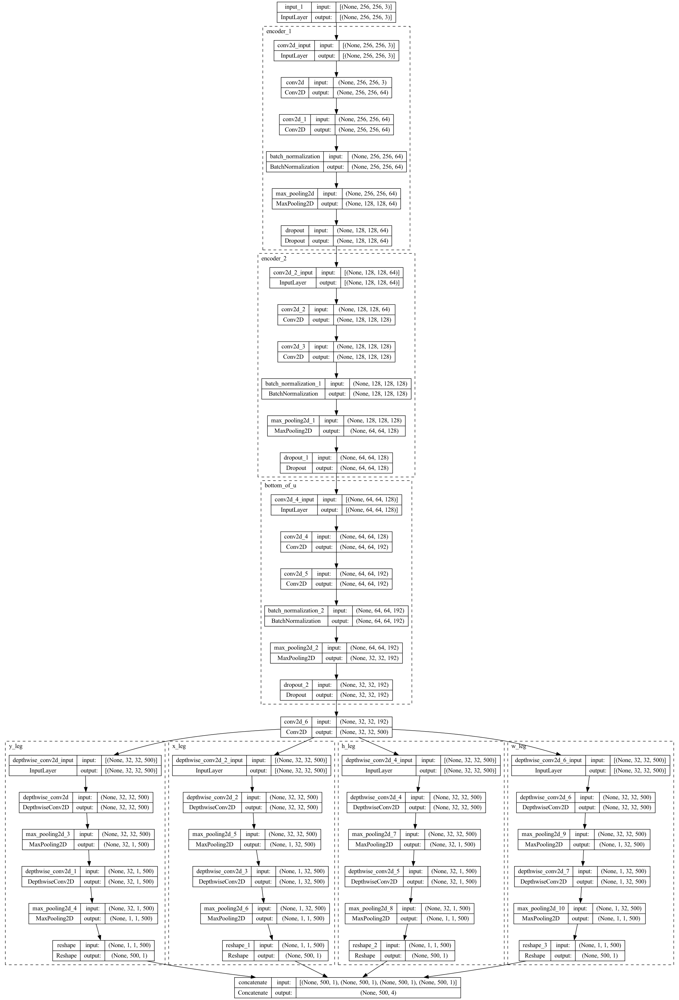

In [23]:
def resize_block(input):
    # [y_input, x_input, h_input, w_input] = layers.Lambda(lambda x: tf.split(x, 4, axis=-1))(input)
    kwargs = dict(padding='same')
    conv = layers.Conv2D(MAX_BOXES, 3, activation='relu', **kwargs)(input)

    y_leg = tf.keras.Sequential([
        layers.DepthwiseConv2D(3, activation='relu', **kwargs),
        layers.MaxPool2D((1, MAX_BOXES), strides=(1, MAX_BOXES), **kwargs),
        layers.DepthwiseConv2D((3, 1), activation='sigmoid', **kwargs),
        layers.MaxPool2D((MAX_BOXES, 1), strides=(MAX_BOXES, 1), **kwargs),
        layers.Reshape([MAX_BOXES, -1]),
    ], name='y_leg')

    x_leg = tf.keras.Sequential([
        layers.DepthwiseConv2D(3, activation='relu', **kwargs),
        layers.MaxPool2D((MAX_BOXES, 1), strides=(MAX_BOXES, 1), **kwargs),
        layers.DepthwiseConv2D((1, 3), activation='sigmoid', **kwargs),
        layers.MaxPool2D((1, MAX_BOXES), strides=(1, MAX_BOXES), **kwargs),
        layers.Reshape([MAX_BOXES, -1]),
    ], name='x_leg')

    h_leg = tf.keras.Sequential([
        layers.DepthwiseConv2D(3, activation='relu', **kwargs),
        layers.MaxPool2D((1, MAX_BOXES), strides=(1, MAX_BOXES), **kwargs),
        layers.DepthwiseConv2D((3, 1), activation='sigmoid', **kwargs),
        layers.MaxPool2D((MAX_BOXES, 1), strides=(MAX_BOXES, 1), **kwargs),
        layers.Reshape([MAX_BOXES, -1]),
    ], name='h_leg')

    w_leg = tf.keras.Sequential([
        layers.DepthwiseConv2D(3, activation='relu', **kwargs),
        layers.MaxPool2D((MAX_BOXES, 1), strides=(MAX_BOXES, 1), **kwargs),
        layers.DepthwiseConv2D((1, 3), activation='sigmoid', **kwargs),
        layers.MaxPool2D((1, MAX_BOXES), strides=(1, MAX_BOXES), **kwargs),
        layers.Reshape([MAX_BOXES, -1]),
    ], name='w_leg')

    output = layers.Concatenate()([
        y_leg(conv),
        x_leg(conv),
        h_leg(conv),
        w_leg(conv), 
    ])

    # output = layers.Concatenate()([
    #     y_leg(y_input), 
    #     x_leg(x_input), 
    #     h_leg(h_input), 
    #     w_leg(w_input), 
    # ])

    return output

def create_model():
    inp = tf.keras.Input((IMG_SIZE, IMG_SIZE, 3))

    encoder_blocks = list(accumulate([inp] + list(range(1, N_ENCODERS+1)), lambda x,
                                     idx: encoder_block(x, idx, name='encoder_{}'.format(idx))))

    # Remove the initial input from the list of encoder blocks
    encoder_blocks.pop(0)

    # Create the mid block. It is kept separate from the encoder blocks
    # because it doesn't have a corresponding decoder block.
    mid_block = encoder_block(
        encoder_blocks[-1], N_ENCODERS+1, name='bottom_of_u')

    # decoder_blocks = list(accumulate([mid_block] + list(enumerate(reversed(encoder_blocks))), lambda x, item: decoder_block(
    #     x, item[1], N_ENCODERS - item[0], 'decoder_{}'.format(item[0]+1))))

    # # Remove the mid block from the list of decoder blocks
    # decoder_blocks.pop(0)

    # output = resize_block(decoder_blocks[-1])
    output = resize_block(mid_block)
    m = tf.keras.Model(inputs=inp, outputs=output)

    lr_schedule = optimizers.schedules.InverseTimeDecay(
        LEARNING_RATE,
        decay_steps=STEPS_PER_EPOCH*LR_DECAY_EPOCHS,
        decay_rate=LR_DECAY_RATE,
        staircase=False)
    optimizer = optimizers.Adam(lr_schedule)
    # loss = compute_hw_loss
    # loss = 'mae'
    # metrics = ['accuracy']
    loss = compute_yxhw_loss
    metrics = []
    m.compile(loss=loss, optimizer=optimizer, metrics=metrics)

    return m

lr_schedule = optimizers.schedules.InverseTimeDecay(
        LEARNING_RATE,
        decay_steps=41,
        decay_rate=LR_DECAY_RATE,
        staircase=False)
optimizer = optimizers.Adam(lr_schedule)

model = create_model()
model.compile(optimizer=optimizer, loss=compute_yxhw_loss)
model.summary()

utils.plot_model(model, show_shapes=True, expand_nested=True)

- [x] Custom training loop to efficiently calculate and emit multiple loss metrics.
- [x] Checkpoints
- [x] Emit box and non-box losses separately. 

In [69]:
channel_width = 500

kwargs = dict(padding='same')
x_leg = tf.keras.Sequential([
    tf.keras.Input((32, 32, channel_width)),
    layers.DepthwiseConv2D(3, activation='relu', **kwargs),
    layers.MaxPool2D((channel_width, 1), strides=(channel_width, 1), **kwargs),
    layers.DepthwiseConv2D((1, 3), activation='sigmoid', **kwargs),
    layers.MaxPool2D((1, channel_width), strides=(1, channel_width), **kwargs),
    layers.Reshape([MAX_BOXES, -1]),
], name='x_leg')

# y_leg = tf.keras.Sequential([
#     tf.keras.Input((32, 32, channel_width)),
#     # layers.Conv2D(initial_channel_width*2, 3, activation='relu', **kwargs),
#     layers.DepthwiseConv2D(3, activation='relu', **kwargs),
#     layers.MaxPool2D((1, channel_width), strides=(1, channel_width), **kwargs),
#     layers.DepthwiseConv2D((3, 1), activation='relu', **kwargs),
#     # layers.Conv2D(MAX_BOXES, (1, 3), activation='sigmoid', **kwargs),
#     layers.MaxPool2D((channel_width, 1), strides=(channel_width, 1), **kwargs),
#     layers.Reshape([MAX_BOXES, -1]),
# ], name='y_leg')

x_leg.summary()

Model: "x_leg"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 depthwise_conv2d_24 (Depthw  (None, 32, 32, 500)      5000      
 iseConv2D)                                                      
                                                                 
 max_pooling2d_108 (MaxPooli  (None, 1, 32, 500)       0         
 ng2D)                                                           
                                                                 
 depthwise_conv2d_25 (Depthw  (None, 1, 32, 500)       2000      
 iseConv2D)                                                      
                                                                 
 max_pooling2d_109 (MaxPooli  (None, 1, 1, 500)        0         
 ng2D)                                                           
                                                                 
 reshape_52 (Reshape)        (None, 500, 1)            0     

In [34]:
@tf.function
def train_step(model, x, y):
    with tf.GradientTape() as tape:
        logits = model(x, training=True)
        yx_loss, hw_loss = model.loss(y, logits)
        # loss = yx_loss + hw_loss
        iou, positive_iou, negative_iou = compute_iou_metric(y, logits)
        loss = 10*yx_loss + (1 - positive_iou) + (2 - negative_iou) + hw_loss


    # Compute gradients and backpropagate.
    grads = tape.gradient(loss, model.trainable_weights)
    # grads = tape.gradient(yx_loss, model.trainable_weights)
    model.optimizer.apply_gradients(zip(grads, model.trainable_weights))

    return yx_loss, hw_loss, iou, positive_iou, negative_iou


@tf.function
def val_step(model, x, y):
    logits = model(x, training=False)
    yx_loss, hw_loss = model.loss(y, logits)
    iou, positive_iou, negative_iou = compute_iou_metric(y, logits)

    return yx_loss, hw_loss, iou, positive_iou, negative_iou

# def auto_train(model, tds, vds, epochs=100, callbacks=[]):
#     # tds = tds.prefetch(buffer_size=tf.data.AUTOTUNE)
#     # vds = vds.prefetch(buffer_size=tf.data.AUTOTUNE) if vds else None
#     tds = tds.prefetch(buffer_size=tf.data.AUTOTUNE).take(1)
#     vds = vds.prefetch(buffer_size=tf.data.AUTOTUNE).take(1) if vds else None

#     # tf.profiler.experimental.start('logdir')
#     history = model.fit(tds, validation_data=vds, epochs=epochs, callbacks=callbacks)
#     # tf.profiler.experimental.stop()

#     return history


def make_prunable_model(model, params):
    print('Pruning is enabled with parameters: {}'.format(params))

    prune_low_magnitude = tfmot.sparsity.keras.prune_low_magnitude
    kwargs = {
        'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(**params)
    }

    # Configure the model for pruning
    pruning_model = prune_low_magnitude(model, **kwargs)
    pruning_model.compile(
        optimizer=model.optimizer,
        loss=model.loss,
        metrics=model.metrics
    )
    pruning_model.summary()

    return pruning_model


km = None

class TrainingHooks(object):
    def __init__(self, params):
        none_fn = lambda: None
        self.on_train_begin = params.get('on_train_begin') or none_fn

def train(model, tds, vds, epochs=100, pruning_params=None):
    global km

    # tds = tds.prefetch(buffer_size=tf.data.AUTOTUNE)
    # vds = vds.prefetch(buffer_size=tf.data.AUTOTUNE) if vds else iter([])
    tds = tds.prefetch(buffer_size=tf.data.AUTOTUNE).take(4)
    vds = vds.prefetch(buffer_size=tf.data.AUTOTUNE).take(
        2) if vds else iter([])
    # tds = tds.prefetch(buffer_size=tf.data.AUTOTUNE).take(1)
    # vds = vds.prefetch(buffer_size=tf.data.AUTOTUNE).take(1) if vds else None

    # Save initial weights and reset them after 'PRUNING_WEIGHT_RESET_EPOCHS' epochs
    model.save_weights('initial_weights.h5')

    # Configure pruning and callbacks
    if(pruning_params):
        m = make_prunable_model(model, pruning_params)
        step_cb = tfmot.sparsity.keras.UpdatePruningStep()
        step_cb.set_model(m)
    else:
        m = model

    # Record progress
    ckpt = tf.train.Checkpoint(optimizer=m.optimizer, model=m)
    ckpt_manager = tf.train.CheckpointManager(ckpt, LOG_DIR, max_to_keep=3)
    history = History()

    # Initialize training hooks
    def on_train_begin():
        # Record the initial learning rate at epoch 0
        history.learning_rate(LEARNING_RATE)
        history.record_and_reset('learning_rate')

        # Signal start of training to the pruning callback
        if (step_cb):
            step_cb.on_train_begin()

    hook_params = dict(
        on_train_begin = on_train_begin
    )
    hooks = TrainingHooks(hook_params)

    km = m
    hooks.on_train_begin()

    for epoch in range(epochs):
        # Track training progress
        print("\nEpoch {}/{}".format(epoch + 1, epochs))
        p_bar = utils.Progbar(
            STEPS_PER_EPOCH, stateful_metrics=history.metric_names)
        steps = 0

        for step, (x, y) in enumerate(iter(tds)):
            if (step_cb):
                step_cb.on_train_batch_begin(-1)

            yx_loss, hw_loss, iou, positive_iou, negative_iou = train_step(
                m, x, y)
            # true_boxes = hw_grid_to_yxhw(y)
            # tf.print('Step: ', step)
            # tf.print('true_boxes: ', true_boxes, true_boxes.shape)
            # tf.print('hw_loss: ', hw_loss, hw_loss.shape)

            p_bar.update(step + 1, values=history.train_step(yx_loss,
                         hw_loss, iou, positive_iou, negative_iou))
            steps += 1

        # Record learning rates
        history.learning_rate(m.optimizer.lr((epoch + 1)*STEPS_PER_EPOCH))

        for x, y in iter(vds):
            yx_loss, hw_loss, iou, positive_iou, negative_iou = val_step(
                m, x, y)

            history.val_step(yx_loss, hw_loss, iou, positive_iou, negative_iou)

        # Display metrics at the end of each epoch.
        p_bar.update(steps, values=history.epoch())

        # Signal epoch end to the pruning callback
        if (step_cb):
            step_cb.on_epoch_end(batch=-1)

        # Save Checkpoint
        print('\nSaved Checkpoint: {}'.format(ckpt_manager.save()))

        # Reset pruning weights after every PRUNING_WEIGHT_RESET_EPOCHS epochs
        if (step_cb and ((epoch + 1) % PRUNING_WEIGHT_RESET_EPOCHS) == 0 and epoch < PRUNING_TRAINING_EPOCHS):
            print('Reloading initial weights after {} epochs'.format(epoch + 1))
            model.load_weights('initial_weights.h5', by_name=True)

    return history


tds = train_prep_ds.batch(2)
# vds = val_prep_ds.batch(256).cache()
# vds = val_prep_ds.batch(2).cache()
vds = None

# hist = train(model, tds, vds, epochs=1)

hist = train(model, tds, vds, epochs=3, pruning_params=dict(
    initial_sparsity=0.50,
    final_sparsity=0.80,
    begin_step=STEPS_PER_EPOCH,
    end_step=STEPS_PER_EPOCH*PRUNING_TRAINING_EPOCHS
))
hist.history


Pruning is enabled with parameters: {'initial_sparsity': 0.5, 'final_sparsity': 0.8, 'begin_step': 805, 'end_step': 805}
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 encoder_1 (Sequential)         (None, 128, 128, 64  77575       ['input_10[0][0]']               
                                )                                                                 
                                                                                                  
 encoder_2 (Sequential)         (None, 64, 64, 128)  443143      ['enc

2023-05-10 11:43:08.050964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


  2/805 [..............................] - ETA: 19:47 - learning_rate: 0.0000e+00 - loss: 6.4589 - yx_loss: 0.2722 - hw_loss: 6.1868 - iou: -0.0015 - positive_iou: 9.2913e-04 - negative_iou: -0.0032  

2023-05-10 11:43:18.663445: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


  3/805 [..............................] - ETA: 1:07:32 - learning_rate: 0.0000e+00 - loss: 5.1292 - yx_loss: 0.2226 - hw_loss: 4.9067 - iou: 0.0071 - positive_iou: 0.0286 - negative_iou: -0.0140   
Saved Checkpoint: ./sequence_of_bboxes/ckpt-1
Reloading initial weights after 1 epochs

Epoch 2/3
  3/805 [..............................] - ETA: 7:14 - learning_rate: 4.8463e-05 - loss: 5.1220 - yx_loss: 0.1743 - hw_loss: 4.9478 - iou: 0.0082 - positive_iou: 0.0094 - negative_iou: -0.0020 - val_loss: 0.0000e+00 - val_yx_loss: 0.0000e+00 - val_hw_loss: 0.0000e+00 - val_iou: 0.0000e+00 - val_positive_iou: 0.0000e+00 - val_negative_iou: 0.0000e+00
Saved Checkpoint: ./sequence_of_bboxes/ckpt-2

Epoch 3/3
  3/805 [..............................] - ETA: 5:44 - learning_rate: 3.2839e-05 - loss: 4.7305 - yx_loss: 0.0910 - hw_loss: 4.6395 - iou: 0.0027 - positive_iou: 0.0038 - negative_iou: -0.0017 - val_loss: 0.0000e+00 - val_yx_loss: 0.0000e+00 - val_hw_loss: 0.0000e+00 - val_iou: 0.0000e+00 - va

{'learning_rate': [0.001, 9.2446455e-05, 4.846336e-05, 3.283941e-05],
 'loss': [5.1292214, 5.1220336, 4.730492],
 'val_loss': [0.0, 0.0, 0.0],
 'yx_loss': [0.22256571, 0.17426844, 0.090987444],
 'val_yx_loss': [0.0, 0.0, 0.0],
 'hw_loss': [4.906656, 4.9477654, 4.6395044],
 'val_hw_loss': [0.0, 0.0, 0.0],
 'iou': [0.0071191727, 0.008169343, 0.0026713107],
 'val_iou': [0.0, 0.0, 0.0],
 'positive_iou': [0.028645502, 0.009433736, 0.0038172288],
 'val_positive_iou': [0.0, 0.0, 0.0],
 'negative_iou': [-0.013952014, -0.0019896813, -0.0016982356],
 'val_negative_iou': [0.0, 0.0, 0.0]}

In [342]:
# km.layers[1].layers[0].get_weights()[0].shape
# list(map(lambda l: l.name, km.trainable_weights))
# model.layers[1].weights[0][0][0][0][0], len(km.layers[1].weights)
# tf.math.reduce_all(tf.math.equal(model.layers[1].weights[2], km.layers[1].weights[2]))
km.layers[1].weights[2].name

'prune_low_magnitude_conv2d_445/mask:0'

In [258]:

# create callback
# use AIP_TENSORBOARD_LOG_DIR to update where logs are written
# tensorboard_cb = cbs.TensorBoard(log_dir='logdir')
# checkpoint_name_tmpl = 'weights-epoch-{epoch:d}-val_loss-{val_loss:.4f}.h5'
# checkpoint_name_tmpl = 'weights-epoch-{epoch:d}-val_accuracy-{val_accuracy:.4f}.h5'
# checkpoint = cbs.ModelCheckpoint(checkpoint_name_tmpl, save_best_only=True, monitor="val_loss")

EPOCHS = 1
# EPOCHS = 50
BATCH_SIZE = 2

PRUNING_SCHED_KWARGS = dict(
    initial_sparsity=0.50,
    final_sparsity=0.80,
    begin_step=STEPS_PER_EPOCH,
    end_step=STEPS_PER_EPOCH*EPOCHS
)

# callbacks = [checkpoint, tensorboard_cb]
# callbacks = [checkpoint]
tds = train_prep_ds.shuffle(500, reshuffle_each_iteration=True).batch(BATCH_SIZE)
# vds = val_prep_ds.batch(256).cache()
vds = val_prep_ds.batch(2).cache()

hist = train(model, tds, vds, epochs=EPOCHS, pruning_params=PRUNING_SCHED_KWARGS)
# hist = auto_train(model, tds, vds, epochs=EPOCHS)

with open('training.results.pkl', 'wb') as f:
    pickle.dump(hist.history, f)


Epoch 1/1
  2/805 [..............................] - ETA: 9:21 - learning_rate: 0.0000e+00 - loss: 5.2535 - yx_loss: 0.1132 - hw_loss: 5.1403 - iou: 8.9504e-04 - positive_iou: 0.0082 - negative_iou: -0.0073 

2023-05-06 12:19:42.505233: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-06 12:19:42.559308: W tensorflow/core/grappler/optimizers/loop_optimizer.cc:907] Skipping loop optimization for Merge node with control input: model_42/decoder_2/center_crop_19/cond/branch_executed/_19


  2/805 [..............................] - ETA: 39:51 - learning_rate: 9.2446e-05 - loss: 5.2535 - yx_loss: 0.1132 - hw_loss: 5.1403 - iou: 8.9504e-04 - positive_iou: 0.0082 - negative_iou: -0.0073 - val_loss: 5.0665 - val_yx_loss: 0.1219 - val_hw_loss: 4.9445 - val_iou: -0.0038 - val_positive_iou: 0.0047 - val_negative_iou: -0.0109

2023-05-06 12:19:44.199511: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.



Saved Checkpoint: ./sequence_of_bboxes/ckpt-1


{'learning_rate': [0.001, 9.2446455e-05, 4.846336e-05, 3.283941e-05],
 'loss': [4.3983893, 4.3774705, 4.3319354],
 'val_loss': [0.0, 0.0, 0.0],
 'yx_loss': [0.15736601, 0.13697024, 0.09191937],
 'val_yx_loss': [0.0, 0.0, 0.0],
 'hw_loss': [4.2410235, 4.2405005, 4.2400165],
 'val_hw_loss': [0.0, 0.0, 0.0],
 'iou': [0.008793744, 0.0062880763, 0.008928862],
 'val_iou': [0.0, 0.0, 0.0],
 'positive_iou': [0.029383428, 0.010216028, 0.029516188],
 'val_positive_iou': [0.0, 0.0, 0.0],
 'negative_iou': [-0.0064718276, -0.00481144, -0.013304184],
 'val_negative_iou': [0.0, 0.0, 0.0]}

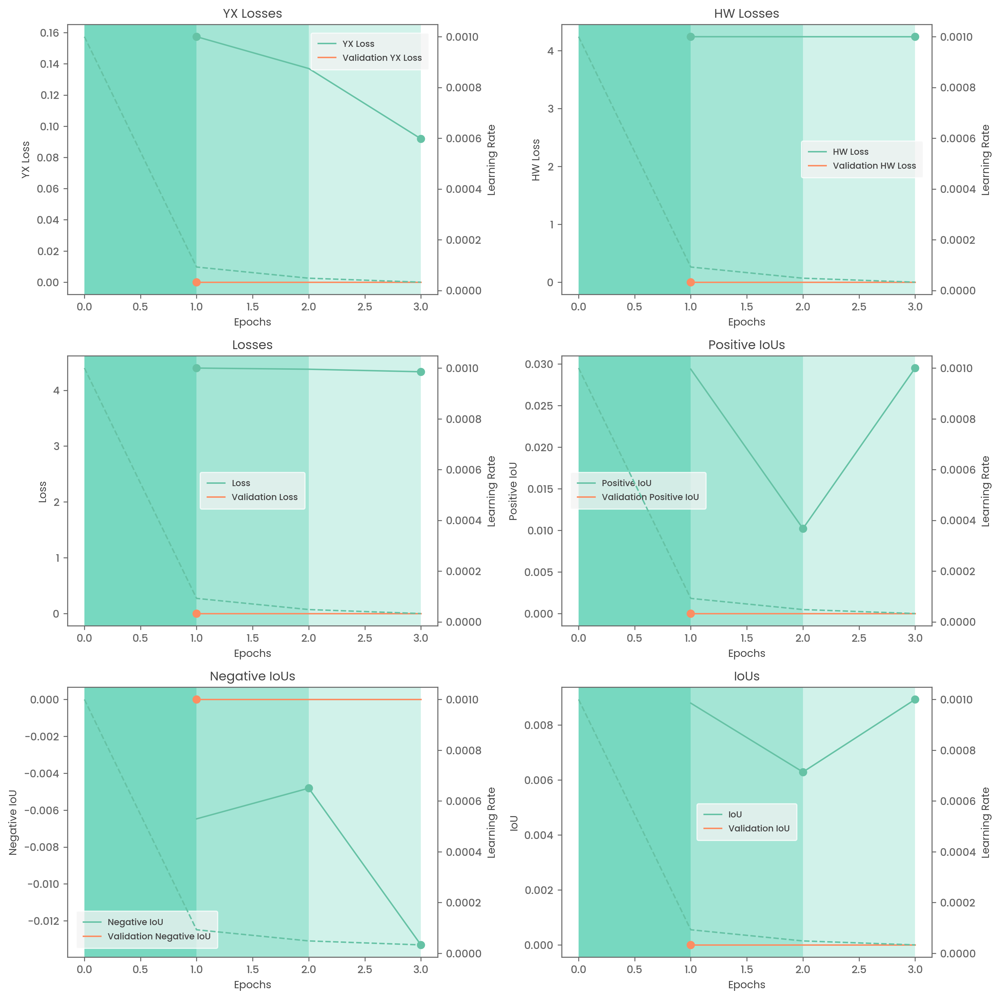

In [20]:
def mark_max_min(ax, column):
    xs = [column.idxmin(), column.idxmax()]
    ys = [column.min(), column.max()]
    
    ax.scatter(xs, ys, zorder=2)

def plot_metrics(ax, df, name, title=None):
    # Plot training metrics
    sns.lineplot(ax=ax, x='Epochs', y=name, data=df, label=name)
    mark_max_min(ax, df[name])

    # Plot validation metrics
    val_name = 'Validation {}'.format(name)
    sns.lineplot(ax=ax, x='Epochs', y=val_name, data=df, label=val_name)
    mark_max_min(ax, df[val_name])

    # Plot learning rates on the right Y-axis
    lr_ax = ax.twinx()
    sns.lineplot(ax=lr_ax, x='Epochs', y='Learning Rate', data=df, linestyle='--')

    for index, lr_value in enumerate(df['Learning Rate'][:-1]):
        ax.axvspan(index, index + 1, fc='#77d8c0', alpha=(1 - (1/(len(df) - 1))*(index)))

    # Label the plots
    ax.legend()
    ax.set_title(title if title else name)

def load_history_as_df(h):
    epochs = len(h['yx_loss'])
    data = list(zip(
        h['yx_loss'],
        h['val_yx_loss'],

        h['hw_loss'],
        h['val_hw_loss'],

        h['loss'],
        h['val_loss'],

        h['positive_iou'],
        h['val_positive_iou'],

        h['negative_iou'],
        h['val_negative_iou'],

        h['iou'],
        h['val_iou'],

        h['learning_rate'][1:]
    ))

    df = pd.DataFrame(data, columns=[
        'YX Loss',
        'Validation YX Loss',

        'HW Loss',
        'Validation HW Loss',

        'Loss',
        'Validation Loss',

        'Positive IoU',
        'Validation Positive IoU',

        'Negative IoU',
        'Validation Negative IoU',

        'IoU',
        'Validation IoU',

        'Learning Rate'
    ], index=range(1, epochs + 1))

    df.at[0, 'Learning Rate'] = h['learning_rate'][0]
    df = df.sort_index()
    df['Epochs'] = df.index

    return df

def plot_history(h):
    fig, axes = plt.subplots(3, 2, figsize=(12, 12), facecolor='w', edgecolor='k')
    axes = axes.ravel()

    yx_loss, hw_loss, loss, positive_iou, negative_iou, iou = axes

    df = load_history_as_df(h)

    # Plot loss metrics
    plot_metrics(yx_loss, df, 'YX Loss', title='YX Losses')
    plot_metrics(hw_loss, df, 'HW Loss', title='HW Losses')
    plot_metrics(loss, df, 'Loss', title='Losses')

    # Plot positive IoU metrics
    plot_metrics(positive_iou, df, 'Positive IoU', title='Positive IoUs')

    # Plot positive IoU metrics
    plot_metrics(negative_iou, df, 'Negative IoU', title='Negative IoUs')

    # Plot IoU metrics
    plot_metrics(iou, df, 'IoU', title='IoUs')

    plt.tight_layout()

plot_history(hist.history)
hist.history

## Model Evaluation

### Evaluation on Training Data

'y_pred'

<tf.Tensor: shape=(2, 10, 4), dtype=float32, numpy=
array([[[0.49546367, 0.5043506 , 0.49998355, 0.49963883],
        [0.49589092, 0.49757466, 0.49979848, 0.500404  ],
        [0.49895862, 0.49762926, 0.500189  , 0.5006884 ],
        [0.5036345 , 0.49486542, 0.5001082 , 0.500348  ],
        [0.5055918 , 0.49546903, 0.50022507, 0.5001273 ],
        [0.5001572 , 0.49932736, 0.50015587, 0.49958754],
        [0.50056905, 0.5042998 , 0.49926552, 0.50101525],
        [0.49948877, 0.49890354, 0.49907798, 0.49888828],
        [0.5003207 , 0.50120544, 0.50007796, 0.5002552 ],
        [0.50223136, 0.5017583 , 0.50022495, 0.50001717]],

       [[0.49477074, 0.5045594 , 0.499986  , 0.4996833 ],
        [0.49523726, 0.49749786, 0.4998156 , 0.5004452 ],
        [0.49889827, 0.49691755, 0.5001973 , 0.5007224 ],
        [0.50385004, 0.4945786 , 0.50013477, 0.5003645 ],
        [0.506135  , 0.49491674, 0.50019795, 0.5001436 ],
        [0.4999631 , 0.49917454, 0.5001506 , 0.49955538],
        [0.5010255

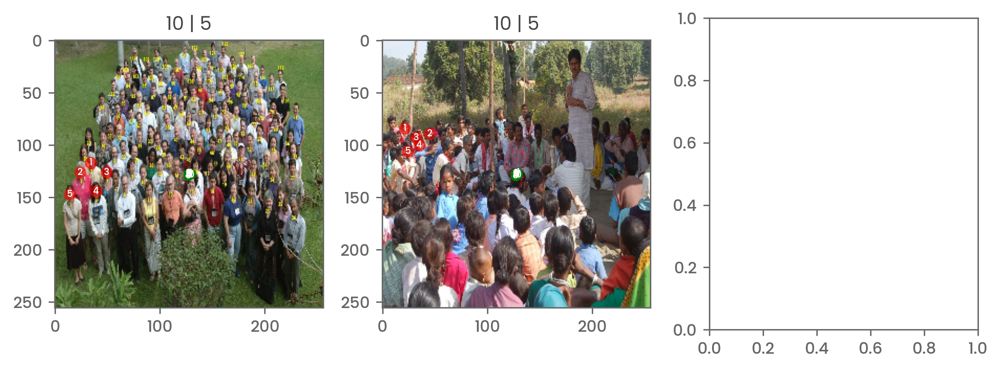

In [21]:
# ds = train_ds.filter(filter_empty_bboxes).map(preprocess)
# itr = iter(ds.batch(20))
itr = iter(train_prep_ds.batch(2))
images, y_true = next(itr)
y_pred = model(images)

# yxhw_preds, yxhw_intersections, _ = evaluate_predictions(y_true, y_pred)
# yxhw_true = yxyx_to_yxhw(y_true)
# # plot_comparisons(images, yxhw_true, yxhw_preds, yxhw_intersections)
# plot_comparisons(images, y_pred[:, :, :, :2], yxhw_true, yxhw_preds, yxhw_intersections, plot_neighbors=True)

# tf.print('yxhw_true: ', yxhw_true, yxhw_true.shape)
# tf.print('yxhw_preds: ', yxhw_preds, [len(yxhw_preds)] + yxhw_preds[0].shape.as_list())
plot_examples(images, y_true, y_pred)
# display('y_true', y_true)
display('y_pred', y_pred)

### Evaluation on Validation Data

'y_pred'

<tf.Tensor: shape=(5, 500, 4), dtype=float32, numpy=
array([[[0.500032  , 0.50001836, 0.5000069 , 0.49999395],
        [0.5000112 , 0.50000674, 0.49998918, 0.49997896],
        [0.5000403 , 0.50000757, 0.5000041 , 0.49999985],
        ...,
        [0.50001115, 0.5000067 , 0.4999882 , 0.49998188],
        [0.5000139 , 0.5001121 , 0.49999753, 0.5000071 ],
        [0.50002867, 0.4999938 , 0.5000067 , 0.5000062 ]],

       [[0.5000813 , 0.5000248 , 0.50000376, 0.49999756],
        [0.5000146 , 0.5000001 , 0.49999502, 0.49999034],
        [0.500125  , 0.5000035 , 0.500002  , 0.5000002 ],
        ...,
        [0.5000188 , 0.49999952, 0.49999544, 0.49999154],
        [0.50000983, 0.5001401 , 0.49999955, 0.5000027 ],
        [0.50005543, 0.5000402 , 0.5000035 , 0.50000274]],

       [[0.5000732 , 0.50001234, 0.50001097, 0.49998987],
        [0.50002044, 0.5000108 , 0.49998498, 0.49997178],
        [0.50009686, 0.5       , 0.5000055 , 0.5000023 ],
        ...,
        [0.5000145 , 0.50000846, 0

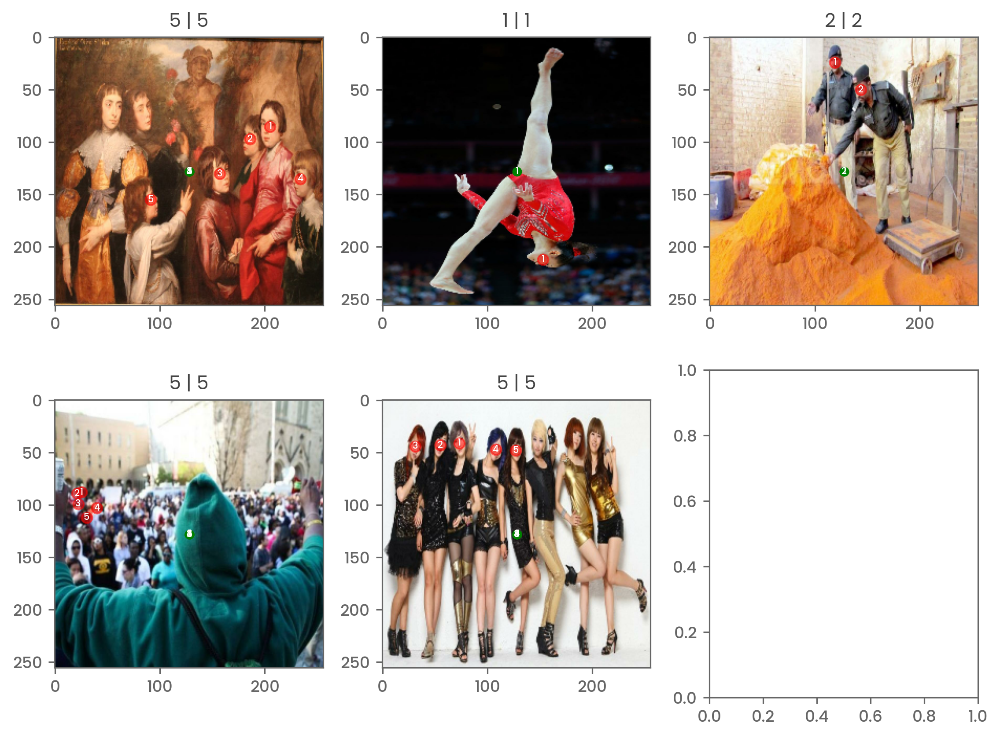

In [217]:
itr = iter(val_prep_ds.batch(5))
images, y_true = next(itr)
y_pred = model(images)

# plot_box_counts(images, y_true, y_pred)
plot_examples(images, y_true, y_pred, match=True)
# plot_examples(images, y_true, None, match=True)
# display('y_pred', y_pred), compute_iou_metric(y_true, y_pred)
# display('y_true', y_true)
display('y_pred', y_pred)

### Evaluation on Test Data

'y_pred'

<tf.Tensor: shape=(2, 100, 4), dtype=float32, numpy=
array([[[6.07766355e-12, 2.79327323e-05, 0.00000000e+00, 0.00000000e+00],
        [9.94542241e-01, 3.28529291e-02, 1.00000000e+00, 1.00000000e+00],
        [1.00562498e-01, 5.37090190e-02, 5.61704159e-01, 1.12368193e-09],
        [6.16238415e-02, 9.90477562e-01, 8.57168132e-08, 1.00000000e+00],
        [3.28546435e-01, 8.93347025e-01, 8.52538347e-02, 1.00000000e+00],
        [9.83706474e-01, 3.24651092e-01, 1.00000000e+00, 1.00000000e+00],
        [5.01551330e-02, 8.76458108e-01, 2.10633702e-13, 8.21596550e-05],
        [8.40980828e-01, 4.28775489e-01, 9.10657585e-01, 9.99999881e-01],
        [8.85805786e-01, 4.39838469e-01, 1.00000000e+00, 1.00000000e+00],
        [4.96642232e-01, 5.53451777e-01, 1.00000000e+00, 1.00000000e+00],
        [5.26450127e-02, 4.57166582e-01, 1.00000000e+00, 1.61147323e-02],
        [1.00395037e-03, 9.99937534e-01, 2.74451788e-30, 1.00000000e+00],
        [4.23822343e-01, 8.39085817e-01, 4.05245152e-16, 7.

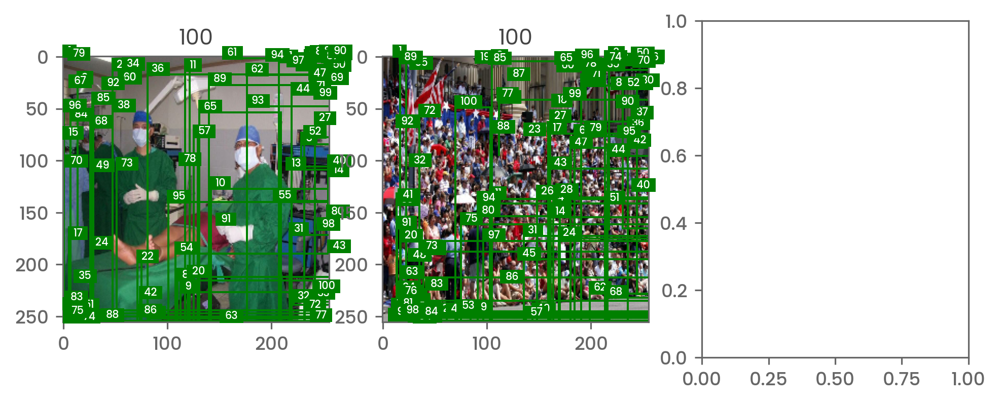

In [ ]:
# ds = test_ds.map(preprocess)
# itr = iter(ds.batch(20))
# # itr = iter(ds.batch(2))
# images, y_true = next(itr)

# y_pred = model(images)


itr = iter(test_prep_ds.batch(2))
images, y_true = next(itr)
y_pred = model(images)

plot_examples(images, None, y_pred)

display('y_pred', y_pred)

## ViT Patch Transformer

### Multilayer Perceptron

In [24]:
def mlp_block(xx, dims, dropout_rate, name='mlp_block'):
    block = tf.keras.Sequential([
        layers.Dense(dims*4, activation='gelu'),
        layers.Dense(dims),
        layers.Dropout(dropout_rate)
    ], name=name)

    return block(xx)

dims, dropout_rate = 8, .2
xx = tf.random.normal((2, 4, 4, 3))
output = mlp_block(xx, dims, dropout_rate)

print('Multilayer Perceptron')
print('dims: {} dropout_rate: {}'.format(dims, dropout_rate))
print('Input: {} --> {}'.format(xx.shape, output.shape))

Multilayer Perceptron
dims: 8 dropout_rate: 0.2
Input: (2, 4, 4, 3) --> (2, 4, 4, 8)


### Embedding Block

In [25]:
def patch_embedding_block(xx, dims, name='patch_embedding_block'):
    """
        It embeds the input patches in dims-dimensional space.

        Arguments:
            xx: A tensor with shape:
                (BATCH_SIZE, N_PATCHES, PATCH_SIZE*PATCH_SIZE*N_CHANNELS)
            dims: Latent dimensions in the embedding space.
        
        Returns:
            A tensor with shape:
                (BATCH_SIZE, N_PATCHES, dims)
    """
    block = tf.keras.Sequential([
        layers.Dense(dims)
    ], name=name)

    return block(xx)

dims = 8
xx = tf.random.normal((2, 4, 12))
output = patch_embedding_block(xx, dims)

print('Embedding Block')
print('dims: {}'.format(dims))
print('Input: {} --> {}'.format(xx.shape, output.shape))

Embedding Block
dims: 8
Input: (2, 4, 12) --> (2, 4, 8)


### Encoder Block

In [26]:
def encoder_block(xx, dims, heads, dropout_rate=0.2, name='encoder_block'):

    normalized_1 = layers.Normalization()(xx)
    x = xx + layers.MultiHeadAttention(heads, dims)(normalized_1, normalized_1)
    normalized_2 = layers.Normalization()(x)
    x = x + mlp_block(normalized_2, dims, dropout_rate, name='{}_mlp'.format(name))

    block = tf.keras.Model(inputs=xx, outputs=x, name=name)

    return block(xx)

dims, heads, dropout_rate = 8, 2, .2
# xx = tf.random.normal((2, 4, dims))
xx = tf.keras.Input((4, dims))
output = encoder_block(xx, dims, heads, dropout_rate=dropout_rate)

print('Encoder Block')
print('dims: {}'.format(dims))
print('Input: {} --> {}'.format(xx.shape, output.shape))

Encoder Block
dims: 8
Input: (None, 4, 8) --> (None, 4, 8)


### Resize Block

In [48]:
def projection_block(xx, boxes=1, name='projection_block'):

    block = tf.keras.Sequential([
        layers.Dense(boxes, activation='sigmoid')
    ], name=name)

    return block(xx)

boxes, dims = 1, 8
xx = tf.keras.Input((1, dims))
output = projection_block(xx, boxes)

print('Projection Block')
print('boxes: {} dims: {}'.format(boxes, dims))
print('Input: {} --> {}'.format(xx.shape, output.shape))

Projection Block
boxes: 1 dims: 8
Input: (None, 1, 8) --> (None, 1, 1)


### Model Assembly

ViT
input_size: 128 encoder_units: 2, dims: 8 heads: 2 boxes: 1
Input: (None, 128, 128, 3) --> (None, 1, 1)


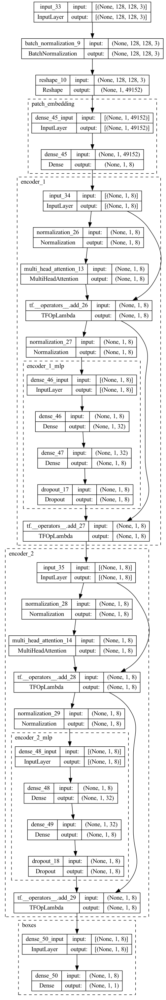

In [49]:
def create_model(input_size, encoder_units, dims, heads, boxes, dropout_rate=0.2):
    xx = tf.keras.Input((input_size, input_size, 3))
    
    x = layers.BatchNormalization()(xx)
    x = layers.Reshape([1, -1])(x)
    x = patch_embedding_block(x, dims, name='patch_embedding')
    encoder_fn = lambda x, i: encoder_block(x, dims, heads, name='encoder_{}'.format(i + 1))
    x = reduce(encoder_fn, range(encoder_units), x)
    x = projection_block(x, boxes=boxes, name='boxes')

    model = tf.keras.Model(inputs=xx, outputs=x, name='PatchTransformer')

    return model

input_size, encoder_units, dims, heads, boxes = IMG_SIZE//2, 2, 8, 2, 1
model = create_model(input_size, encoder_units, dims, heads, boxes)

xx = tf.keras.Input((128, 128, 3))
# output = model
output = model(xx)

print('ViT')
print('input_size: {} encoder_units: {}, dims: {} heads: {} boxes: {}'.format(
    input_size,
    encoder_units,
    dims,
    heads,
    boxes
))
print('Input: {} --> {}'.format(xx.shape, output.shape))

utils.plot_model(model, show_shapes=True, expand_nested=True)

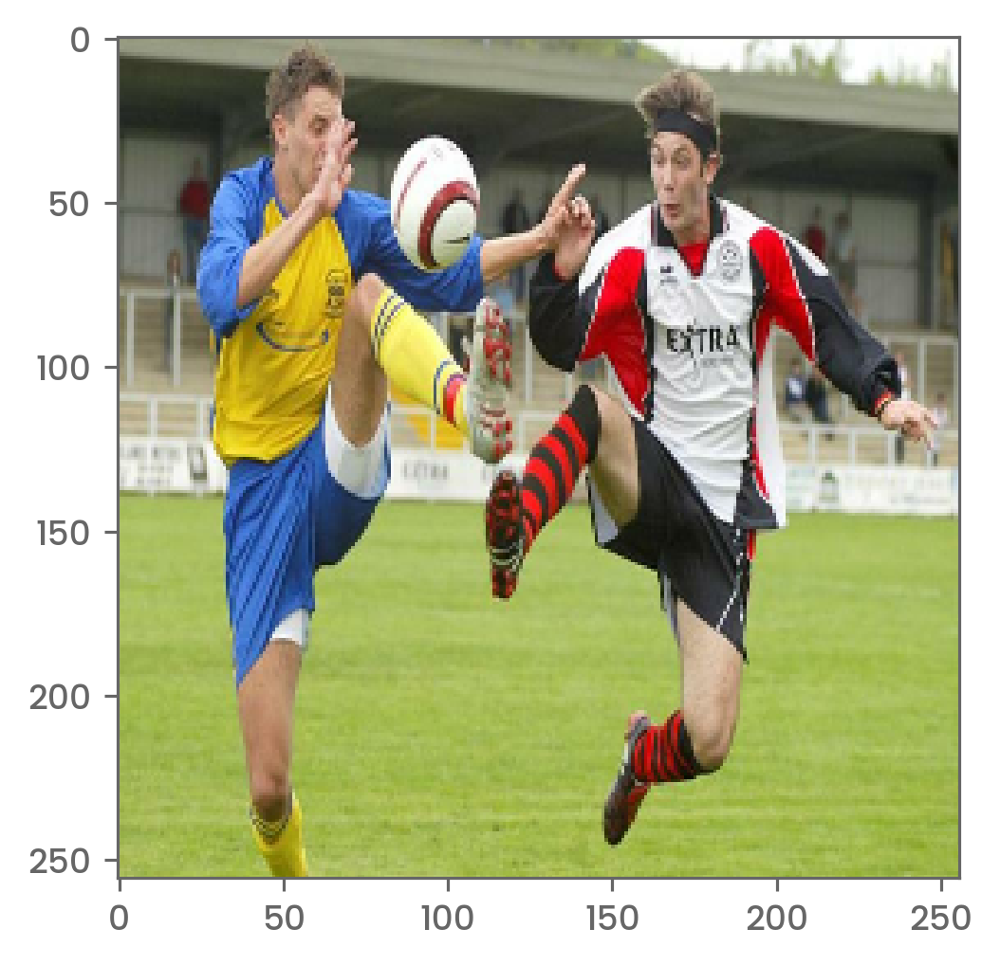

In [36]:
my_ds, = tfds.load(
    'wider_face',
    # split=['train[:80%]', 'train[80%:]', 'test'],
    split=['train[39:]'],
    # split=['train', 'validation', 'test'],
    read_config=tfds.ReadConfig(try_autocache=False)
)

ds = my_ds.filter(filter_empty_bboxes).map(preprocess_as_center_grid, num_parallel_calls=None)


itr = iter(ds.batch(1))
image, y_true = next(itr)

plt.imshow(image[0])

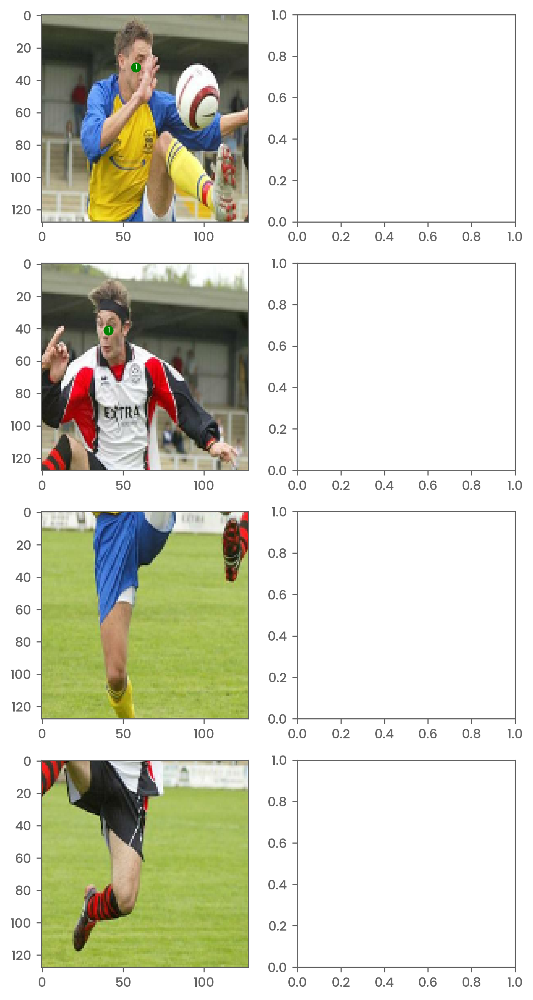

In [43]:
def plot_in_out(axes, in_img=None, in_boxes=None, out_img=None, out_boxes=None, size=IMG_SIZE):
    # _, [in_ax, out_ax] = plt.subplots(2, figsize=(6, 12))
    [in_ax, out_ax] = axes

    if in_img is not None: in_ax.imshow(in_img[0])
    if in_boxes is not None: plot_box_centers(in_ax, in_boxes, size)
    if out_img is not None: out_ax.imshow(out_img[0])

# boxes = hw_grid_to_yxhw(y_true[0])

patch_size = IMG_SIZE//2
top_left = image[:, :patch_size, :patch_size]
top_right = image[:, :patch_size, patch_size:]
bottom_left = image[:, patch_size:, :patch_size]
bottom_right = image[:, patch_size:, patch_size:]
num_patches = 4

tl_box_grid = y_true[:, :patch_size, :patch_size, :]
tr_box_grid = y_true[:, :patch_size, patch_size:, :]
bl_box_grid = y_true[:, patch_size:, :patch_size, :]
br_box_grid = y_true[:, patch_size:, patch_size:, :]

tl_boxes = hw_grid_to_yxhw(tl_box_grid[0])
tr_boxes = hw_grid_to_yxhw(tr_box_grid[0])
bl_boxes = hw_grid_to_yxhw(bl_box_grid[0])
br_boxes = hw_grid_to_yxhw(br_box_grid[0])

# _, [tl_ax, tr_ax, bl_ax, br_ax] = plt.subplots(4, figsize=(4, 16))
_, [tl_ax, tr_ax, bl_ax, br_ax] = plt.subplots(4, 2, figsize=(6, 12))

plot_in_out(tl_ax, top_left, tl_boxes, size=IMG_SIZE//2)
plot_in_out(tr_ax, top_right, tr_boxes, size=IMG_SIZE//2)
plot_in_out(bl_ax, bottom_left, bl_boxes, size=IMG_SIZE//2)
plot_in_out(br_ax, bottom_right, br_boxes, size=IMG_SIZE//2)

In [51]:
model([top_left])

<tf.Tensor: shape=(1, 1, 1), dtype=float32, numpy=array([[[0.89942145]]], dtype=float32)>

## Evaluate external models

### Load external models

In [93]:
# from keras import backend as K

# pruning_params=dict(
#     initial_sparsity=0.50,
#     final_sparsity=0.80,
#     begin_step=STEPS_PER_EPOCH,
#     end_step=STEPS_PER_EPOCH*PRUNING_TRAINING_EPOCHS
# )

# external_model = make_prunable_model(model, pruning_params)

# ckpt = tf.train.Checkpoint(optimizer=external_model.optimizer, model=external_model)
# ckpt_manager = tf.train.CheckpointManager(ckpt, './sequence_of_bboxes', max_to_keep=3)
# ckpt.restore(ckpt_manager.latest_checkpoint)

y_leg = external_model.layers[-5]
y_leg_input_call = K.function([external_model.input], [external_model.layers[-6].output])

### Partial Model Execution

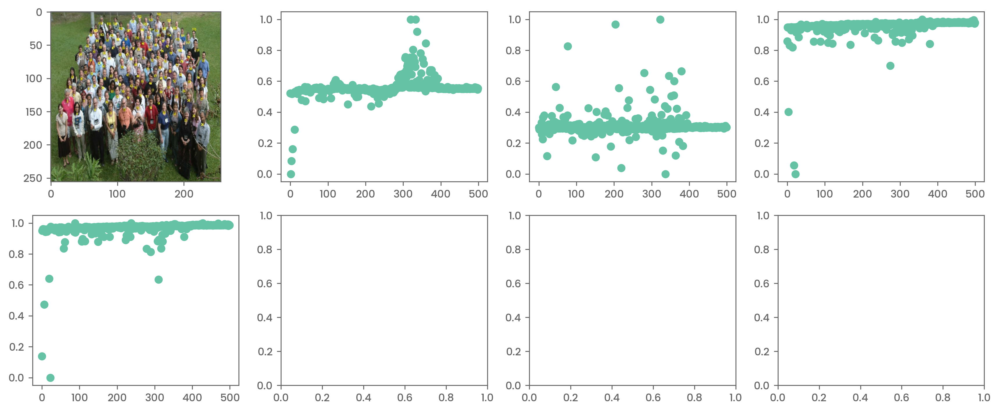

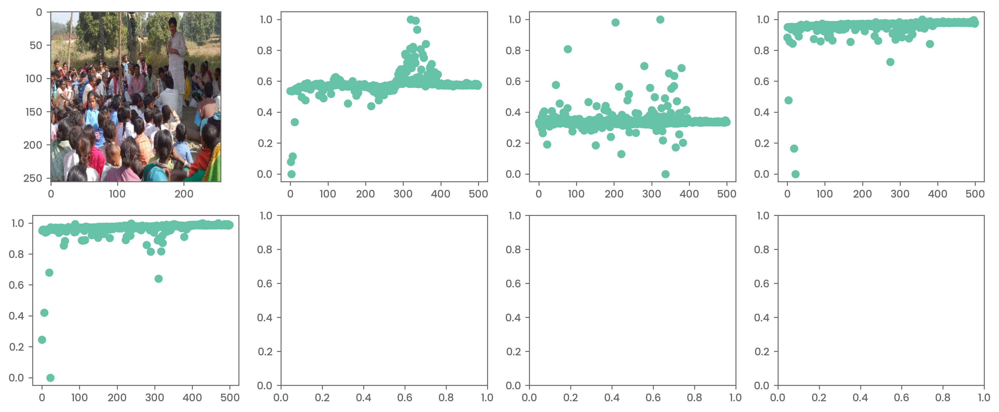

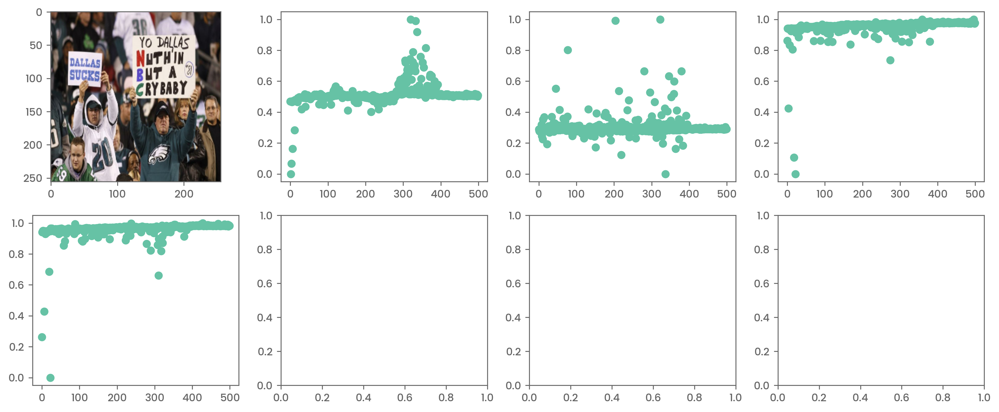

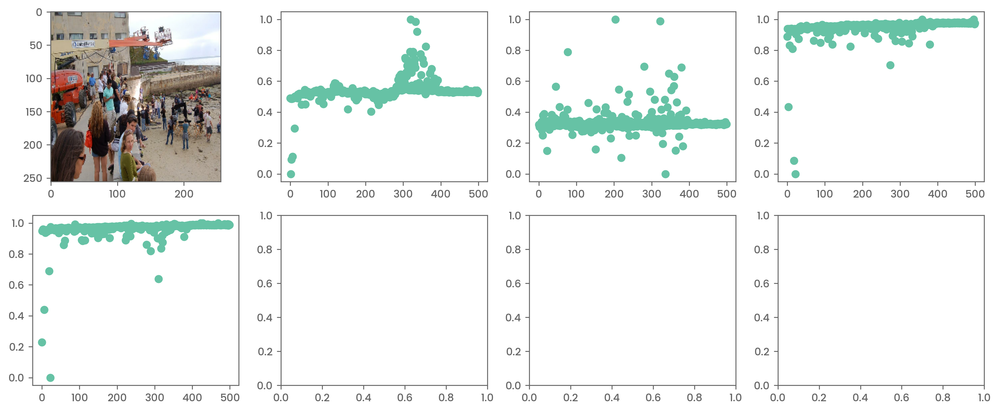

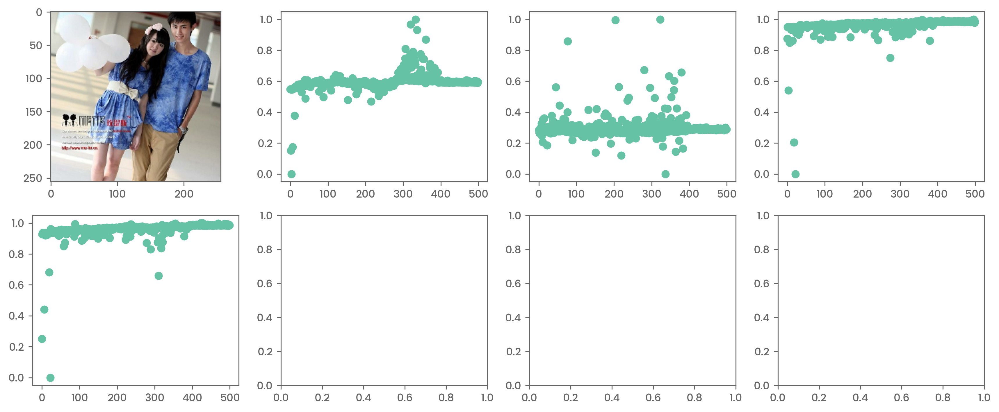

In [114]:
def rescale(x, targetMin, targetMax):
    dataMin = tf.math.reduce_min(x)

    if dataMin < 0:
        x -= dataMin
        dataMin = 0
    
    dataMax = tf.math.reduce_max(x)
    rescaled = (targetMax - targetMin)*(x - dataMin)/(dataMax - dataMin) + targetMin

    return rescaled

def rescale_and_plot_channels(image, x, cols=4, channels=None):
    channels = min(channels or x.shape[-1], x.shape[-1])
    rows = (channels + cols)//cols

    _, axes = plt.subplots(rows, cols, figsize=(12, 2.5*rows))
    axes = axes.ravel()

    axes[0].imshow(image)

    for channel_id in range(channels):
        rescaled = rescale(x[:, :, channel_id:channel_id+1], 0, 1)
        # axes[channel_id + 1].imshow(rescaled, cmap='gray')
        axes[channel_id + 1].scatter(range(500), rescaled)
    
    plt.tight_layout()

def plot_weights_2d(images, weights, cols=4, channels=20):
    num_items= weights.shape[0]

    for item_id in range(num_items):
        rescale_and_plot_channels(images[item_id], weights[item_id], channels=channels)

# itr = iter(val_prep_ds.batch(2))
# images, y_true = next(itr)
# y_pred = external_model(images)

# plot_examples(images, y_true, y_pred)

# display('y_pred', y_pred)

# y_1_conv_output = y_1_conv_call(images)
# y_2_conv_output = y_2_conv_call(images)
# y_3_conv_output = y_3_conv_call(images)
# y_4_conv_output = y_4_conv_call(images)

# plot_weights_2d(images, y_1_conv_output[0])
# plot_weights_2d(images, y_2_conv_output[0])
# plot_weights_2d(images, y_3_conv_output[0])
# plot_weights_2d(images, y_4_conv_output[0])

# y_leg_input = y_leg_input_call(images)
# plot_weights_2d(images, y_leg_input[0])

m_output = external_model(images)
plot_weights_2d(images, tf.expand_dims(m_output, axis=1))